## Install and Import Libraries and Models

In [1]:
# Install the required libraries
#SAM
!pip install git+https://github.com/facebookresearch/segment-anything.git
#Transformers
!pip install -q git+https://github.com/huggingface/transformers.git
#Datasets to prepare data and monai if you want to use special loss functions
!pip install datasets
!pip install -q monai
#Patchify to divide large images into smaller patches for training. (Not necessary for smaller images)
!pip install patchify
!pip install scikit-image

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/segment-anything.git to /scratch/local/30093286/pip-req-build-r1h79u8z
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /scratch/local/30093286/pip-req-build-r1h79u8z
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import os
from patchify import patchify 
import random

## Work With Data

In [3]:
from PIL import Image
import os

def combine_masks(masks_folder):
  combined_mask = None
  for filename in os.listdir(masks_folder):
    if filename.endswith(".png"):
        mask_path = os.path.join(masks_folder, filename)
        mask = Image.open(mask_path)
        if combined_mask is None:
            combined_mask = np.array(mask)
        else:
            combined_mask = np.maximum(combined_mask, np.array(mask))
  return Image.fromarray(combined_mask)

def create_train_dataset(data_dir):
  dataset = []
  for folder in os.listdir(data_dir):
    if os.path.isdir(os.path.join(data_dir, folder, "images")):
      image_path = os.path.join(data_dir, folder, "images", f"{folder}.png")  # Assuming image name matches folder name
      masks_folder = os.path.join(data_dir, folder, "masks")
      if os.path.exists(image_path) and os.path.isdir(masks_folder):
        image = Image.open(image_path)
        combined_mask = combine_masks(masks_folder)
        dataset.append({"image": image, "mask": combined_mask})
        
  return dataset

# Replace with your actual data directory
data_dir = "/home/divyaupadhyay/blue_cai4104/divyaupadhyay/project/data/data-science-bowl-2018/stage1_train/"
stage1_train_dataset = create_train_dataset(data_dir)

In [4]:
stage1_train_dataset[0]['image'].size

(347, 260)

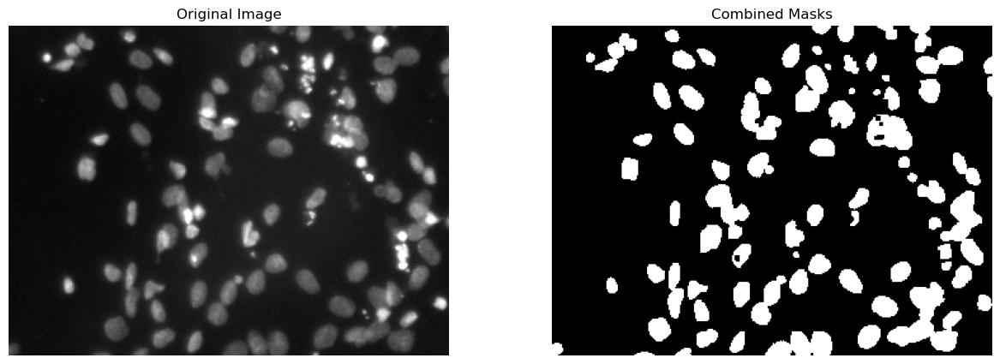

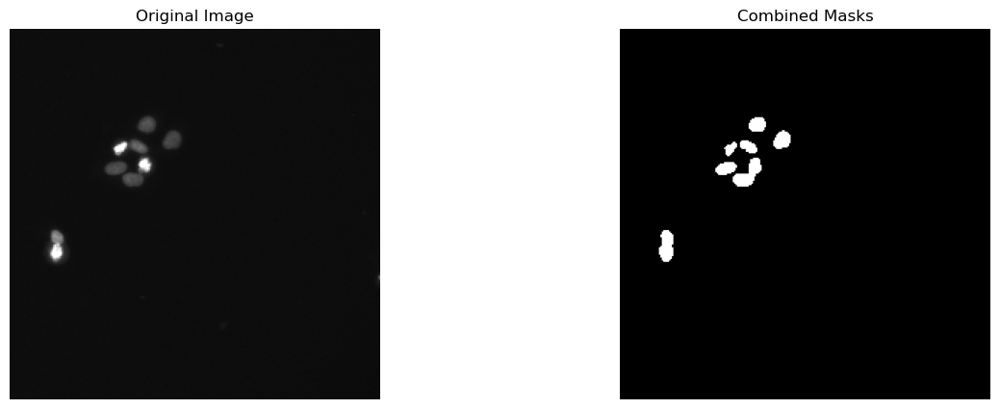

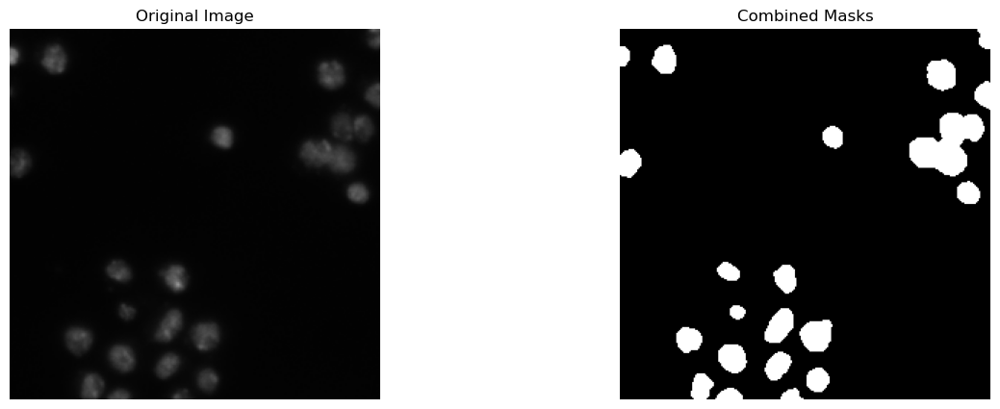

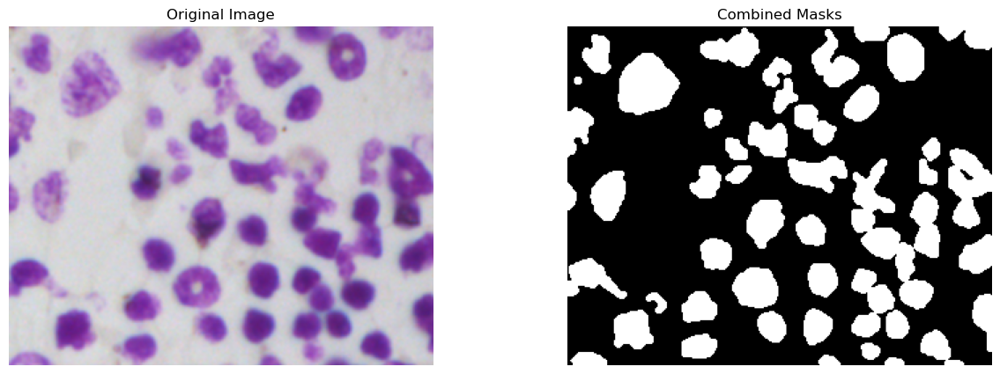

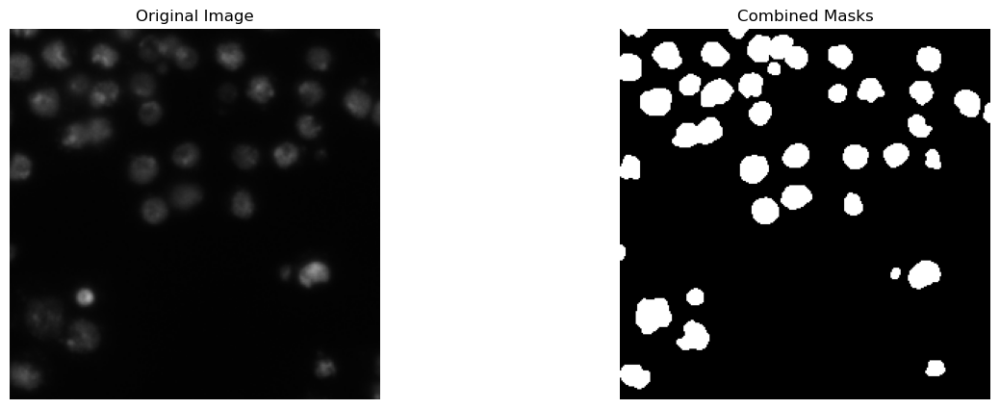

In [5]:
for data in stage1_train_dataset[:5]:
    image = data["image"]
    masks = data["mask"]
    
    # Display image and masks
    plt.figure(figsize=(15, 5))
    
    # Plot the original image
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    
    # Plot the combined masks
    plt.subplot(1, 2, 2)
    plt.imshow(masks, cmap='gray')
    plt.title("Combined Masks")
    plt.axis("off")
    
    plt.show()
    # break  # Remove this line if you want to display all images in the dataset

In [6]:
print("Number of Samples: ", len(stage1_train_dataset))

random.shuffle(stage1_train_dataset)
split_index = int(len(stage1_train_dataset) * 0.8)
train_dataset_tmp = stage1_train_dataset[:split_index]
validation_dataset_tmp = stage1_train_dataset[split_index:]

# Now you have separate train_dataset and validation_dataset for training and validation
print("Number of Train Samples: ", len(train_dataset_tmp))
print("Number of Validation Samples: ", len(validation_dataset_tmp))

Number of Samples:  670
Number of Train Samples:  536
Number of Validation Samples:  134


## Model Traning and Evaluation

In [7]:
# lets see images shapes
print("Training Image Shape: ",train_dataset_tmp[3]['image'].size)
print("Training Masks Shape: ",train_dataset_tmp[3]['mask'].size)

Training Image Shape:  (256, 256)
Training Masks Shape:  (256, 256)


In [8]:
for img in train_dataset_tmp:
    print(img, type(img['image']), type(img['mask']))
    break

{'image': <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=320x256 at 0x149A5DA99720>, 'mask': <PIL.Image.Image image mode=L size=320x256 at 0x149A5DA99810>} <class 'PIL.PngImagePlugin.PngImageFile'> <class 'PIL.Image.Image'>


In [9]:
from datasets import Dataset
from PIL import Image
from torchvision import transforms  # Import transforms for resizing

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to target size (256x256)
    # transforms.ToTensor(),  # Convert to PyTorch tensor (optional, depending on your needs)
])

# Convert, transform, and store images and masks
train_dataset_dict = {
    "image": [transform(Image.fromarray(np.array(img['image'].convert("RGB")))) for img in train_dataset_tmp],
    "label": [transform(Image.fromarray(np.array(img['mask'].convert("L")))) for img in train_dataset_tmp],
}

validation_dataset_dict = {
    "image": [transform(Image.fromarray(np.array(img['image'].convert("RGB")))) for img in validation_dataset_tmp],
    "label": [transform(Image.fromarray(np.array(img['mask'].convert("L")))) for img in validation_dataset_tmp],
}

# Create the dataset using the datasets.Dataset class
train_dataset = Dataset.from_dict(train_dataset_dict)
validation_dataset = Dataset.from_dict(validation_dataset_dict)


/apps/pytorch/2.2.0/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [10]:
train_dataset

Dataset({
    features: ['image', 'label'],
    num_rows: 536
})

In [11]:
def get_bounding_boxes(ground_truth_map):
  if not np.any(ground_truth_map > 0):
    # Handle empty mask (return default bounding box)
    return [[0, 0, ground_truth_map.shape[1], ground_truth_map.shape[0]]]

  # Use scikit-image for connected component analysis
  from skimage import measure

  labels = measure.label(ground_truth_map > 0)  # Label connected components
  regions = measure.regionprops(labels)  # Get properties of each region

  bounding_boxes = []
  for region in regions:
    y_min, x_min, y_max, x_max = region.bbox[:4]  # Extract bounding box coordinates
    # Add perturbation (optional, adjust as needed)
    H, W = ground_truth_map.shape
    x_min = max(0, x_min - np.random.randint(0, 20))
    x_max = min(W, x_max + np.random.randint(0, 20))
    y_min = max(0, y_min - np.random.randint(0, 20))
    y_max = min(H, y_max + np.random.randint(0, 20))
    bounding_boxes.append([x_min, y_min, x_max, y_max])

  return bounding_boxes

In [12]:
from torch.utils.data import Dataset

class SAMDataset(Dataset):
  """
  This class is used to create a dataset that serves input images and masks.
  It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
  """
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor
    
  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["label"])

    # get bounding box prompt
    prompt = get_bounding_boxes(ground_truth_mask)
    all_inputs = []
    for bounding_box in prompt:
      # Prepare image and prompt for each bounding box
      inputs = self.processor(image, input_boxes=[[bounding_box]], return_tensors="pt")

      # Remove batch dimension (might not be necessary if processor handles it)
      inputs = {k: v.squeeze(0) for k, v in inputs.items()}

      # Add ground truth segmentation mask
      inputs["ground_truth_mask"] = ground_truth_mask  # Same mask for all boxes

      all_inputs.append(inputs)

    return all_inputs  # Return a list of inputs (one for each bounding box)

In [13]:
# Initialize the processor
from transformers import SamProcessor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

In [14]:
# Create an instance of the SAMDataset
train_dataset = SAMDataset(dataset=train_dataset, processor=processor)

In [15]:
for batch in train_dataset:
    print(len(batch), type(batch))
    for values in batch:
        print(len(values), type(values))
        print(values["pixel_values"].shape, values["input_boxes"].shape) 
    break

60 <class 'list'>
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch.Size([3, 1024, 1024]) torch.Size([1, 4])
5 <class 'dict'>
torch

In [16]:
# Create a DataLoader instance for the training dataset
from torch.utils.data import DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True, drop_last=True)

In [17]:
batch = next(iter(train_dataloader))
for val in batch:
    for k,v in val.items():
      print(k,v.shape)
    break

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])
ground_truth_mask torch.Size([1, 256, 256])


In [18]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

In [19]:
from torch.optim import Adam
import monai
# Initialize the optimizer and the loss function
optimizer = Adam(model.mask_decoder.parameters(), lr=1e-5, weight_decay=0)
#Try DiceFocalLoss, FocalLoss, DiceCELoss
seg_loss = monai.losses.DiceCELoss(sigmoid=True, squared_pred=False, reduction='mean')

In [20]:
from monai.metrics import compute_iou

def calculate_iou(predicted_mask, ground_truth_mask):
    # Ensure tensors are on the same device
    predicted_mask = predicted_mask.to(ground_truth_mask.device)

    # Flatten predicted and ground truth masks to facilitate computation
    predicted_mask = predicted_mask.flatten(1)
    ground_truth_mask = ground_truth_mask.flatten(1)

    # Calculate IoU using MONAI's compute_iou function
    iou = compute_iou(predicted_mask, ground_truth_mask, include_background=False)

    return iou.item()# Extract the single IoU value

# import torch

# def calculate_iou(predicted_mask, ground_truth_mask):
#   # Ensure tensors are on the same device
#   predicted_mask = predicted_mask.to(ground_truth_mask.device)

#   # Flatten predicted and ground truth masks (optional)
#   # If your masks are single-channel (no background class), flattening can improve efficiency.
#   # If they have multiple channels (including background), keep them as-is.
#   if predicted_mask.shape[1] == 1 and ground_truth_mask.shape[1] == 1:
#       predicted_mask = predicted_mask.flatten(1)
#       ground_truth_mask = ground_truth_mask.flatten(1)

#   # Intersection
#   intersection = (predicted_mask * ground_truth_mask).sum()

#   # Union
#   union = (predicted_mask + ground_truth_mask).sum() - intersection

#   # Avoid division by zero (if both masks are empty)
#   iou = intersection / (union + 1e-6)  # Add a small epsilon to avoid division by zero

#   return iou.item()  # Extract the single IoU value


In [21]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize
from copy import deepcopy  # For deep copying model weights

# Training loop
num_epochs = 3  # Increased epochs to demonstrate early stopping
# patience = 10  # Number of epochs to wait for IoU improvement

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")
model.to(device)

model.train()
best_iou = 0  # Initialize best IoU for early stopping
# no_improvement_since = 0  # Track epochs without IoU improvement

for epoch in range(num_epochs):
    epoch_losses = []
    for batch in tqdm(train_dataloader):
        # Iterate through each sample (image) and its multiple bounding boxes
        for values in batch:
            image = values["pixel_values"]
            bounding_boxes = values["input_boxes"]

            # Move image and bounding boxes to device (CPU or GPU)
            image = image.to(device)
            bounding_boxes = bounding_boxes.to(device)

            # Forward pass for each image and its bounding boxes
            outputs = model(pixel_values=image.to(device),
                            input_boxes=bounding_boxes.to(device),
                            multimask_output=False)

            # Compute loss (adjust based on your specific loss function)
            predicted_masks = outputs.pred_masks.squeeze(0).squeeze(0)
            ground_truth_masks = values["ground_truth_mask"].float().to(device)
            loss = seg_loss(predicted_masks, ground_truth_masks)

            # Backward pass and optimize (same as before)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            epoch_losses.append(loss.item())

            # Calculate IoU
            iou = calculate_iou(predicted_masks, ground_truth_masks)

            # Print loss and IoU for each step
            # print(f"Epoch: {epoch+1}, Step: {len(epoch_losses)}, Loss: {loss.item():.4f}, IoU: {iou:.4f}")

#             # Early stopping with IoU
#             if iou > best_iou:
#                 best_iou = iou
#                 best_model_weights = deepcopy(model.state_dict())  # Deep copy weights
#                 no_improvement_since = 0  # Reset counter on improvement
#             else:
#                 no_improvement_since += 1

#             # Early stopping based on patience
#             if no_improvement_since >= patience:
#                 print(f"Early stopping triggered after {no_improvement_since} epochs without IoU improvement.")
#                 torch.save(model.state_dict(), "/home/divyaupadhyay/blue_cai4104/divyaupadhyay/project/models/best_model.pth")
#                 break  # Exit the inner batch loop
    torch.save(model.state_dict(), f"/home/divyaupadhyay/blue_cai4104/divyaupadhyay/project/models/best_model_{epoch+1}.pth")
    print(f'EPOCH: {epoch+1}')
    print(f'Mean loss: {mean(epoch_losses)}')

Using device: cuda


100%|██████████| 536/536 [38:51<00:00,  4.35s/it] 


EPOCH: 1
Mean loss: 48368.90325064422


100%|██████████| 536/536 [38:49<00:00,  4.35s/it] 


EPOCH: 2
Mean loss: 48133.903622367834


100%|██████████| 536/536 [38:45<00:00,  4.34s/it] 


EPOCH: 3
Mean loss: 48087.70372782318


## Inference

In [22]:
from transformers import SamModel, SamConfig, SamProcessor
import torch

In [23]:
# Load the model configuration
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

# Create an instance of the model architecture with the loaded configuration
my_sam_model = SamModel(config=model_config)
#Update the model by loading the weights from saved file.
my_sam_model.load_state_dict(torch.load(f"/home/divyaupadhyay/blue_cai4104/divyaupadhyay/project/best_model/best_model_{epoch+1}.pth"))

<All keys matched successfully>

In [24]:
device = "cuda" if torch.cuda.is_available() else "cpu"
my_sam_model.to(device)

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=0: 0.1003


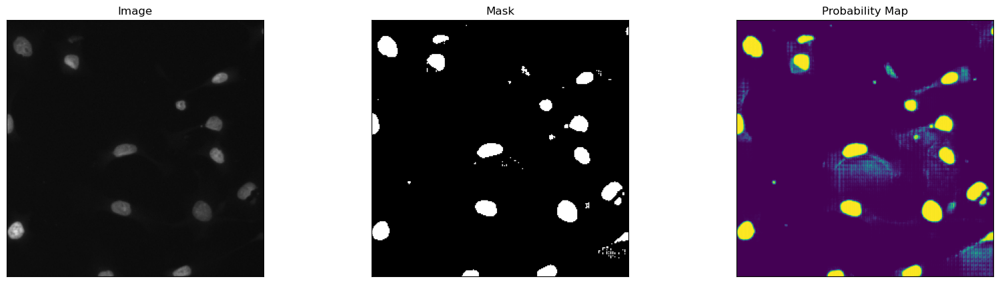

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=1: 0.1042


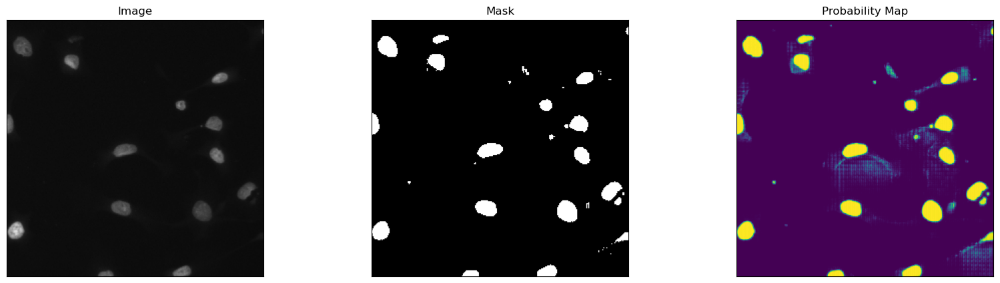

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=2: 0.1019


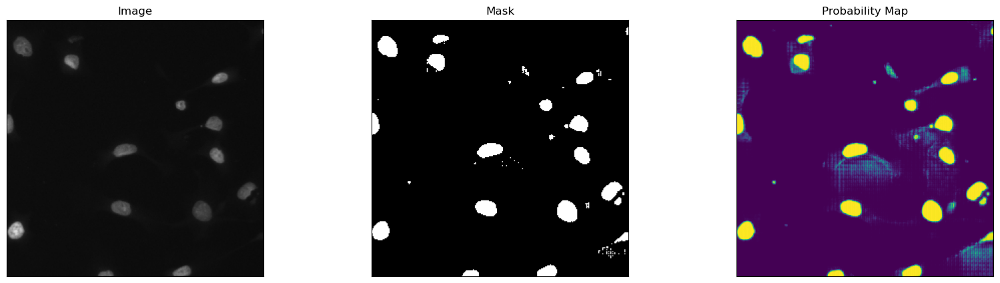

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=3: 0.1025


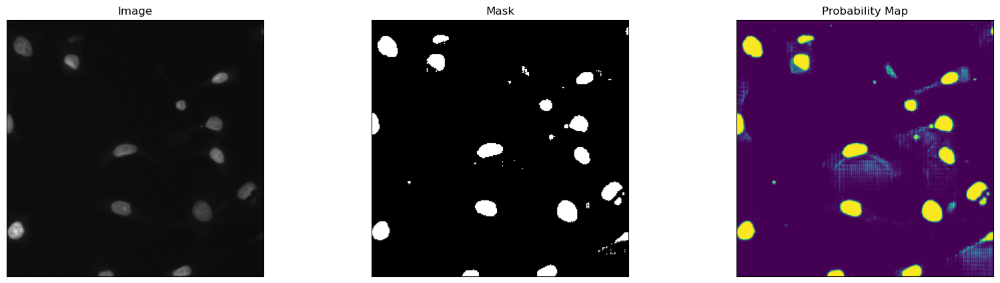

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=4: 0.1020


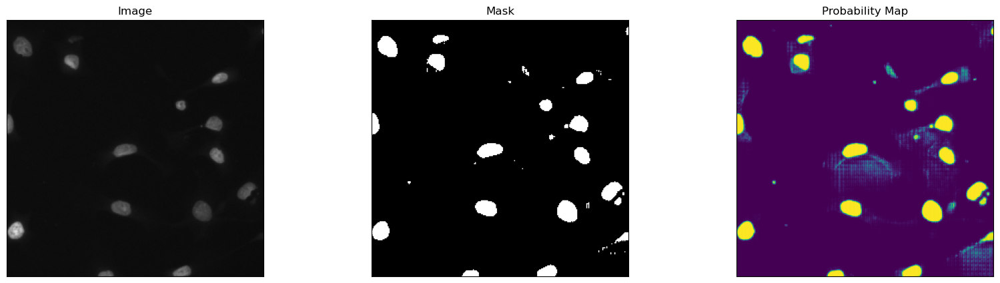

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=5: 0.1015


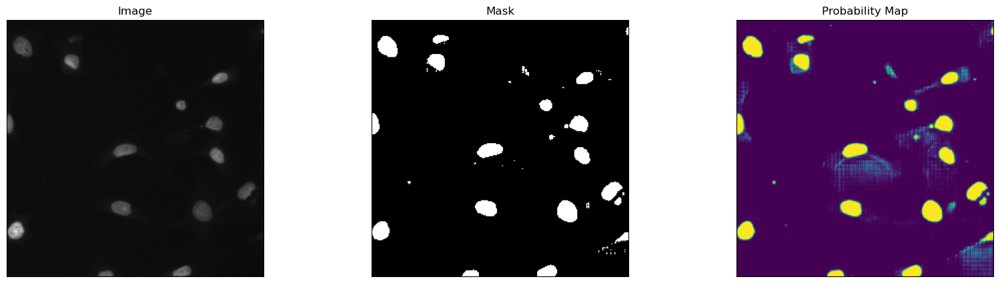

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=6: 0.1020


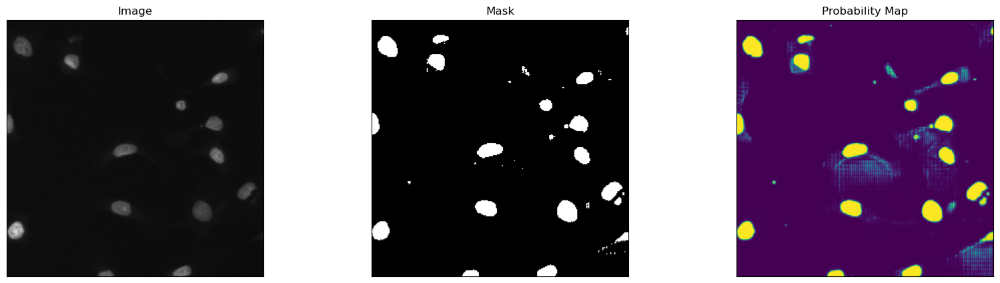

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=7: 0.1018


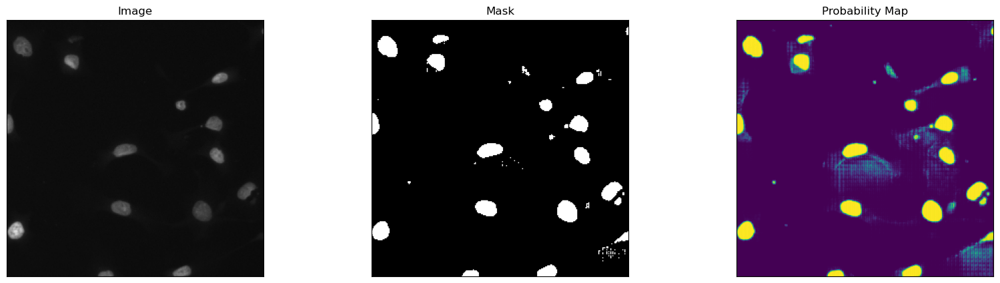

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=8: 0.1038


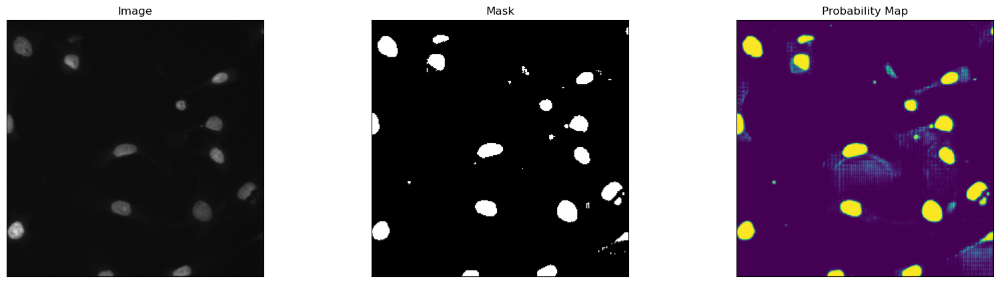

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=9: 0.1008


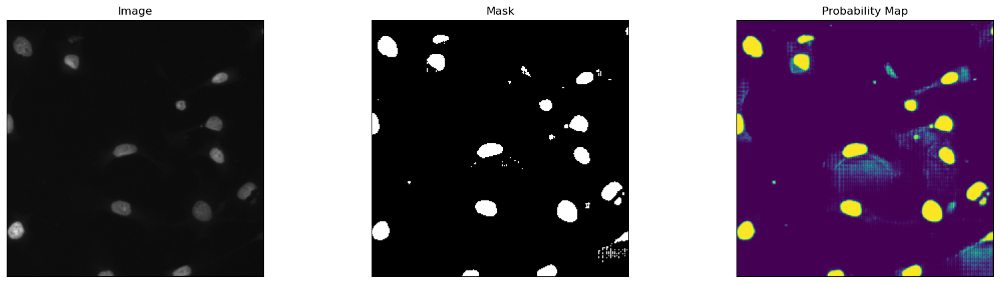

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=10: 0.1029


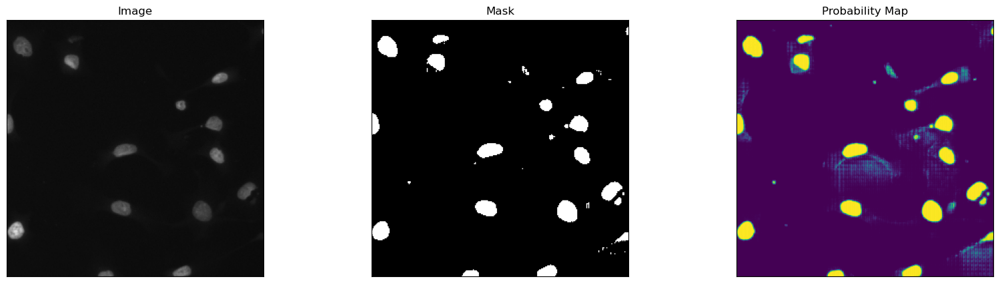

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=11: 0.1014


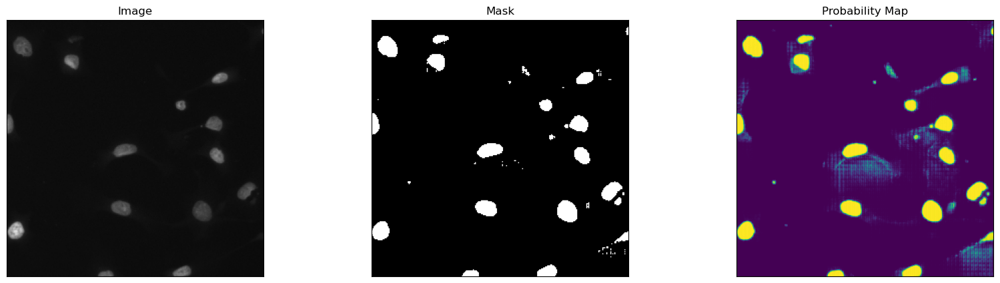

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=12: 0.1042


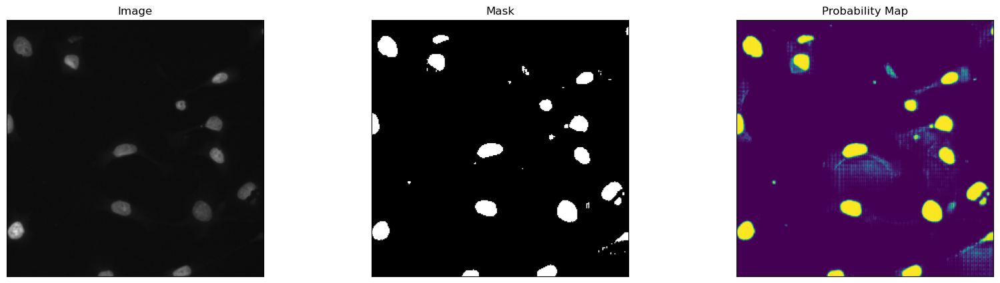

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=13: 0.1021


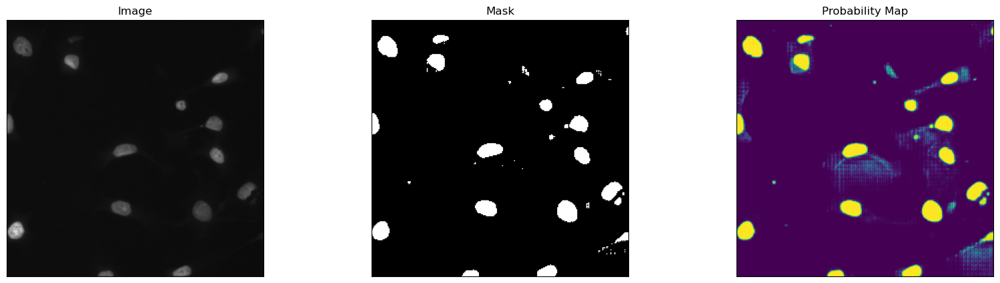

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=14: 0.1041


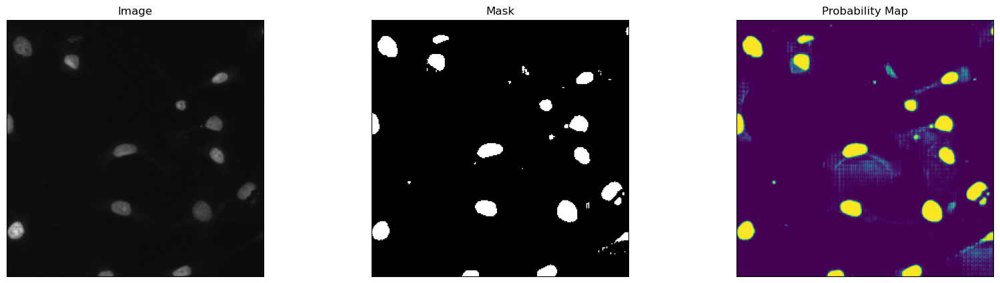

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=15: 0.1036


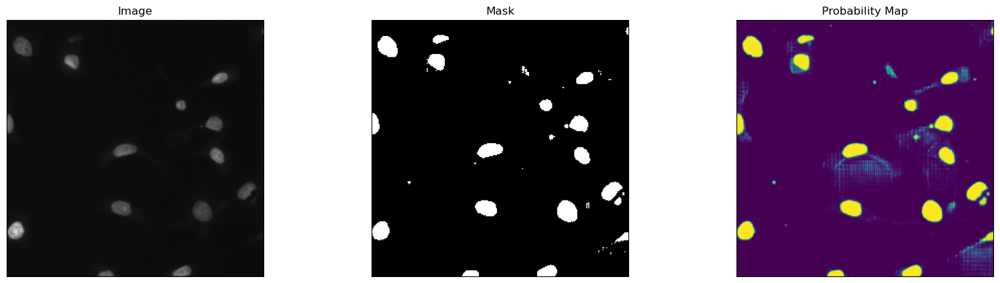

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=16: 0.1016


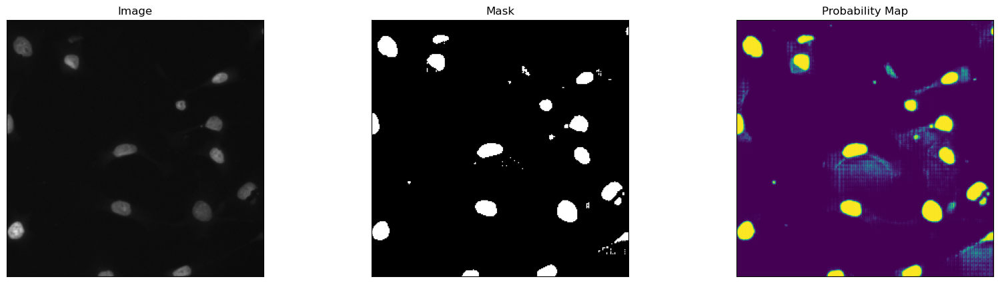

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=17: 0.1011


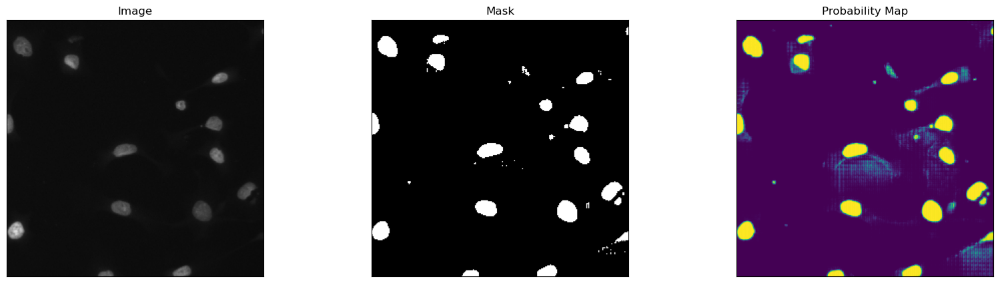

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=18: 0.1005


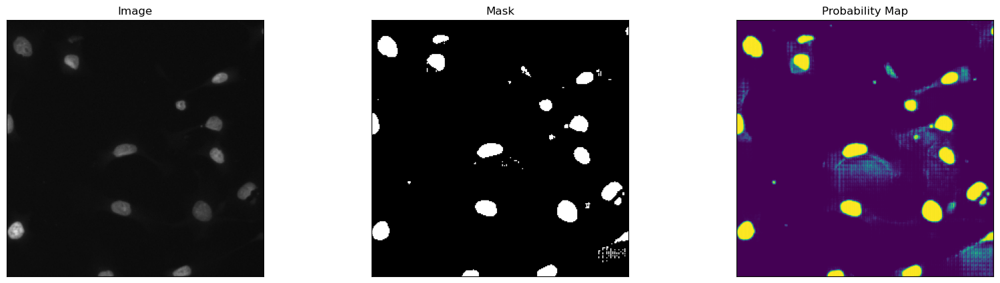

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=19: 0.1004


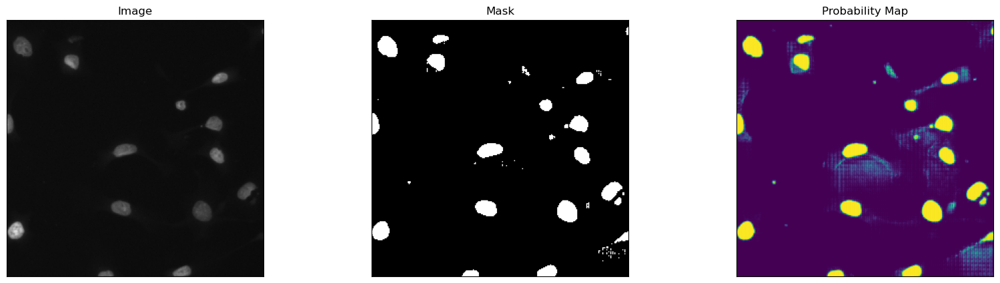

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=20: 0.1034


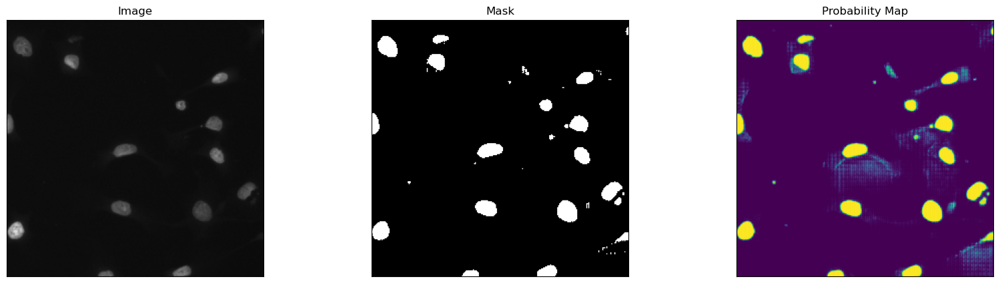

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=21: 0.1018


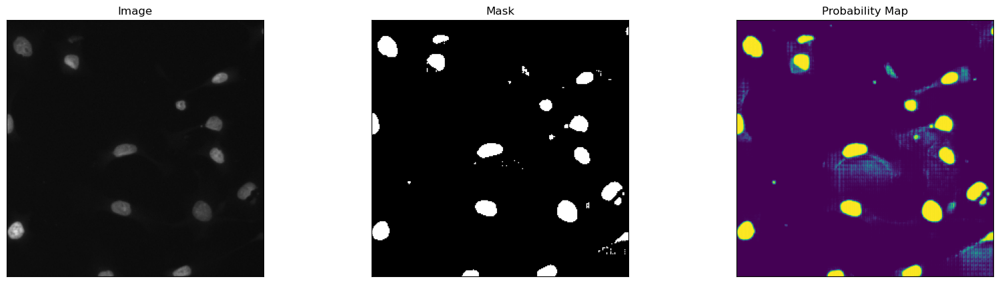

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=22: 0.1010


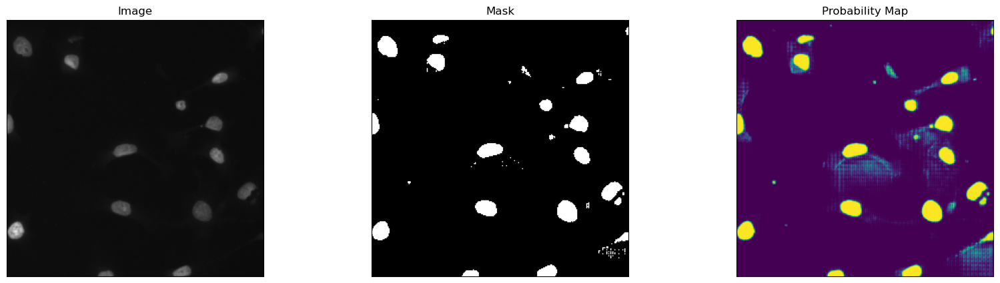

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=23: 0.1011


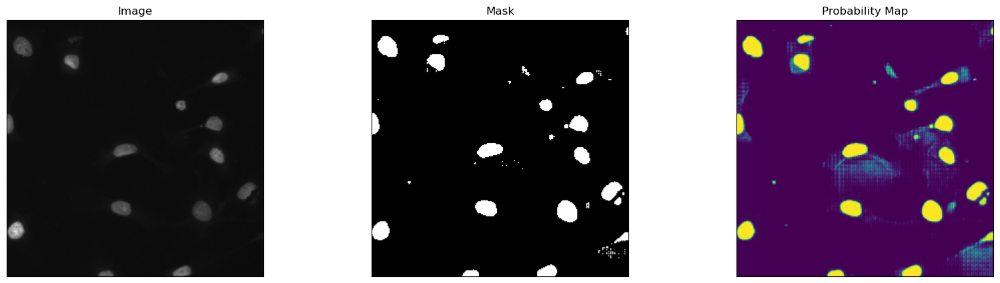

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=24: 0.1004


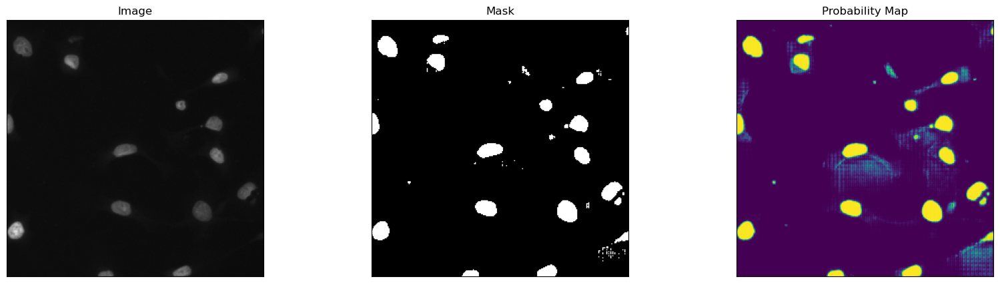

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=25: 0.1026


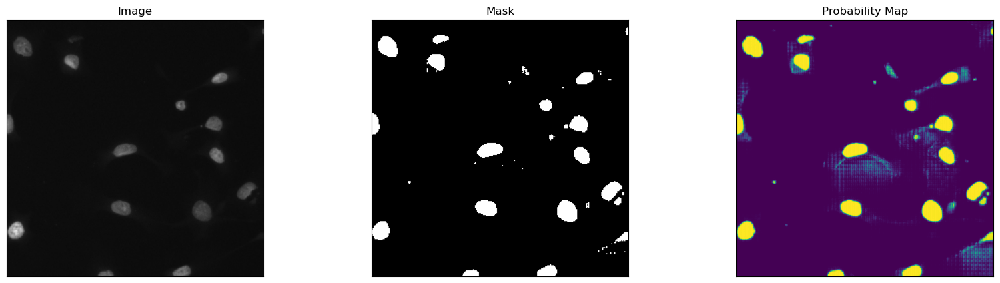

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=26: 0.1027


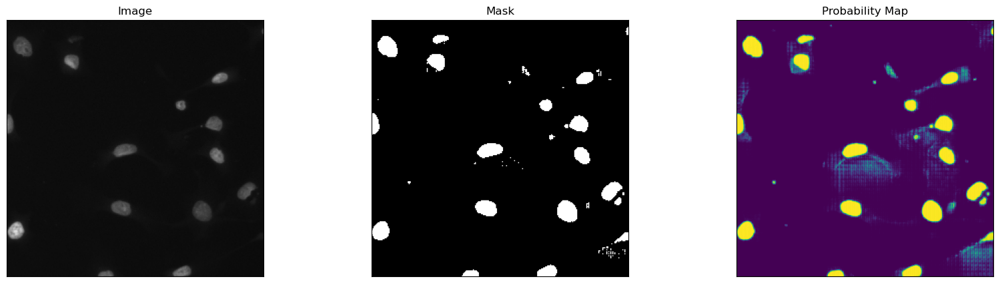

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=27: 0.1018


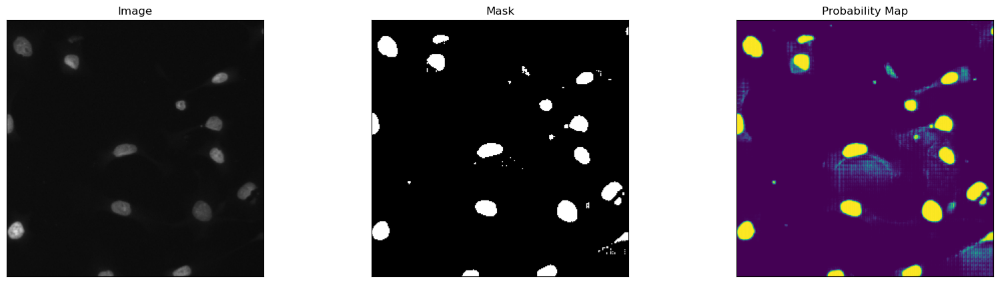

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=28: 0.1023


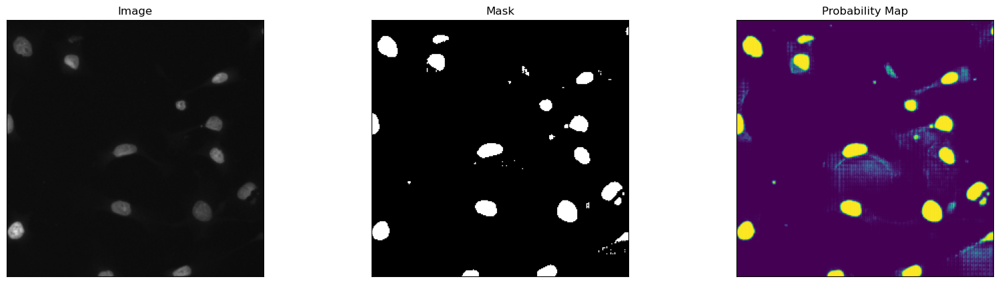

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=29: 0.1027


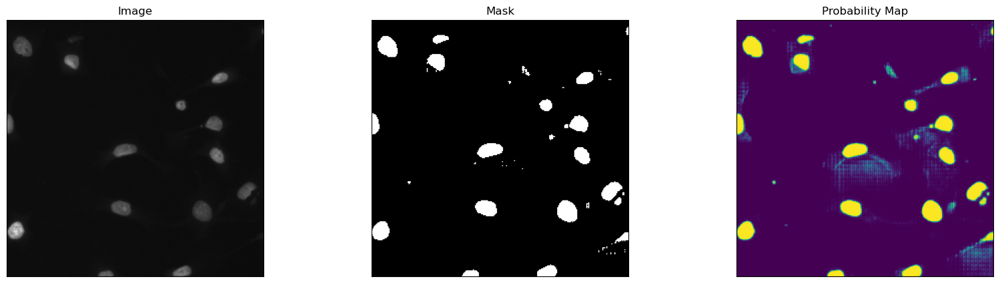

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=30: 0.1038


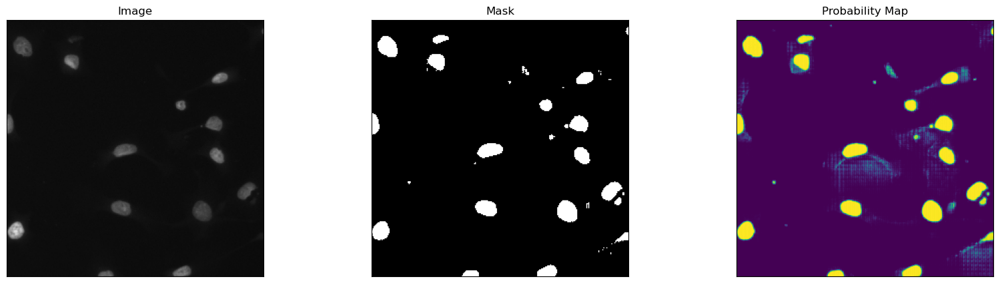

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=31: 0.1048


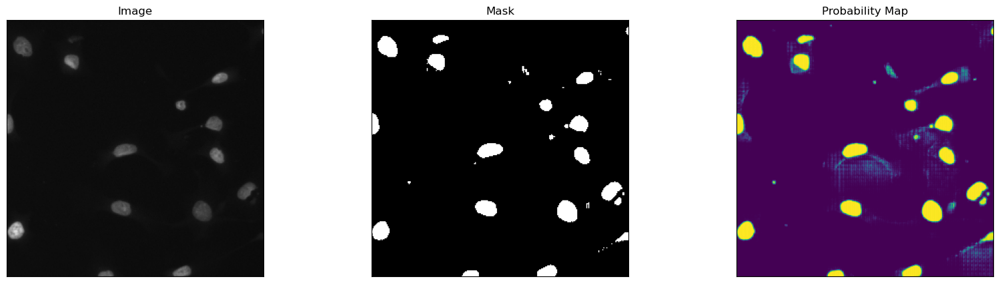

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=32: 0.1025


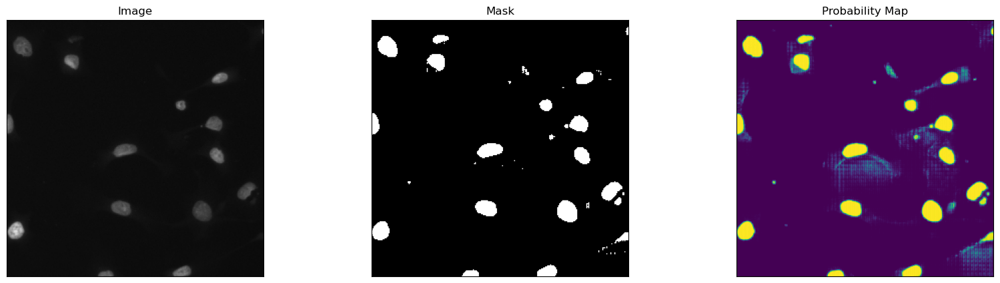

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=33: 0.1022


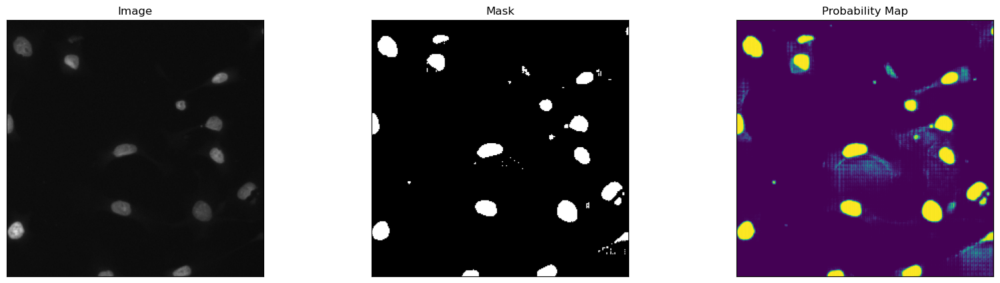

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=34: 0.1006


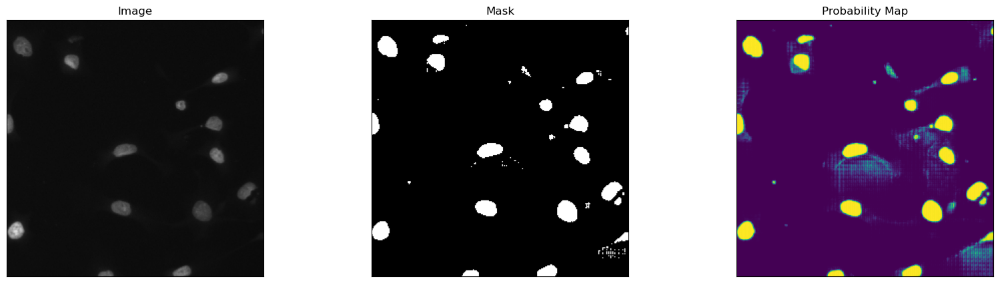

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=35: 0.1036


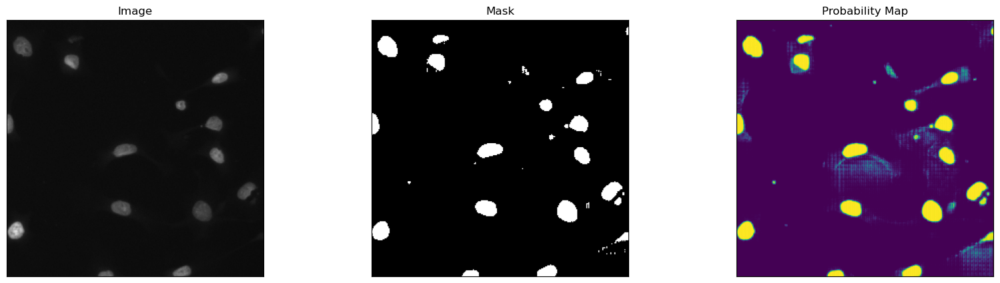

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=36: 0.1046


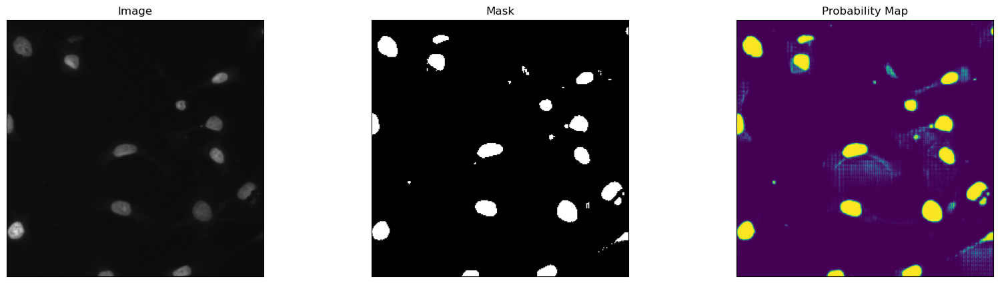

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=37: 0.1010


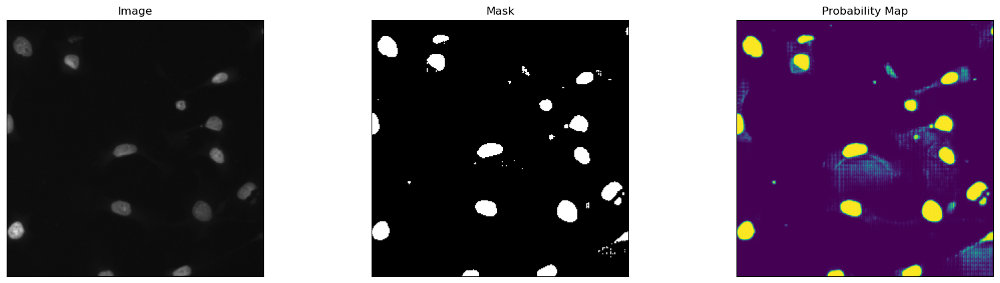

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=38: 0.1021


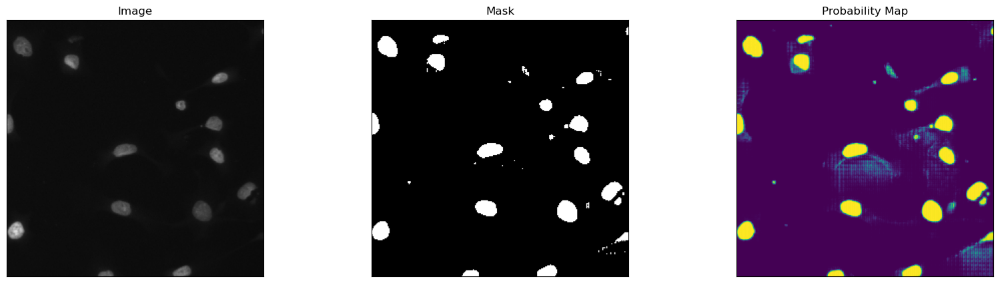

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=39: 0.1036


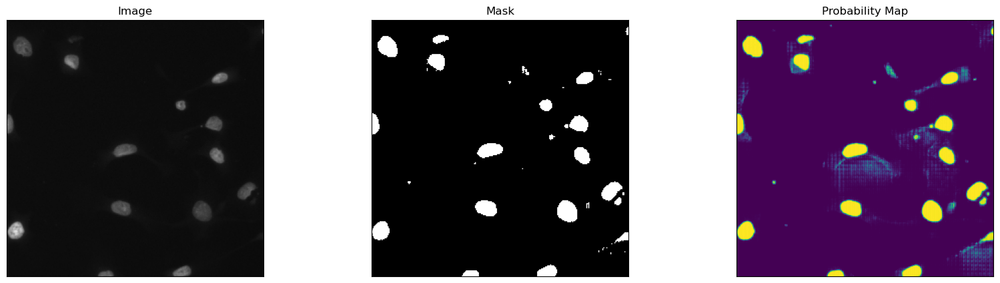

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=40: 0.1038


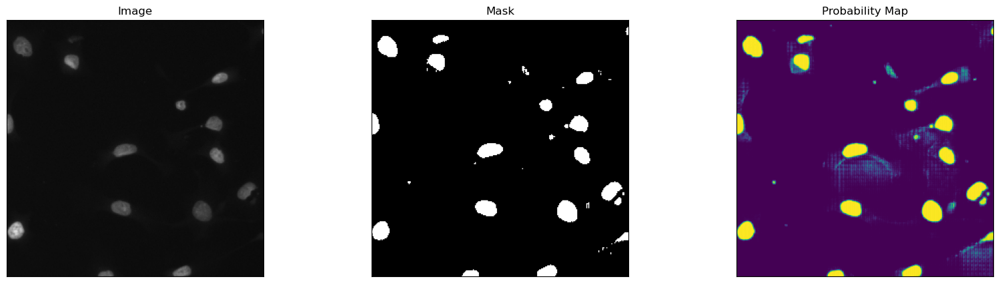

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=41: 0.1003


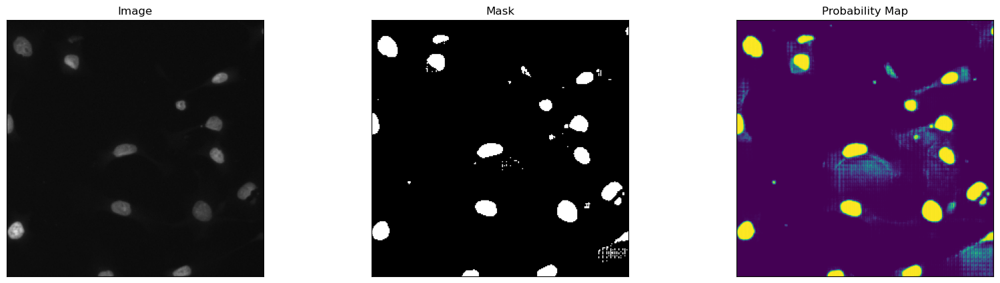

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=42: 0.1009


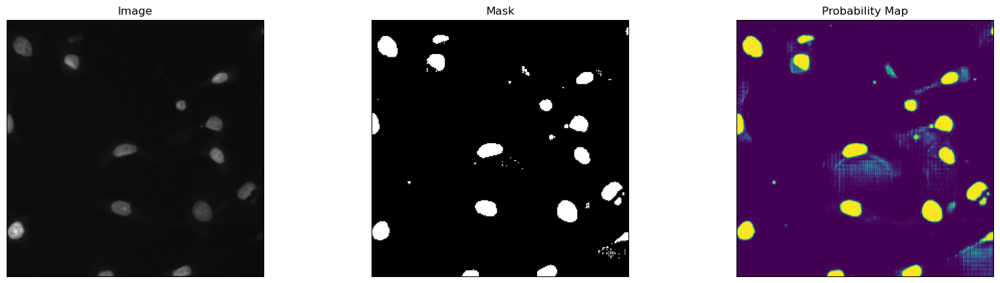

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=43: 0.1033


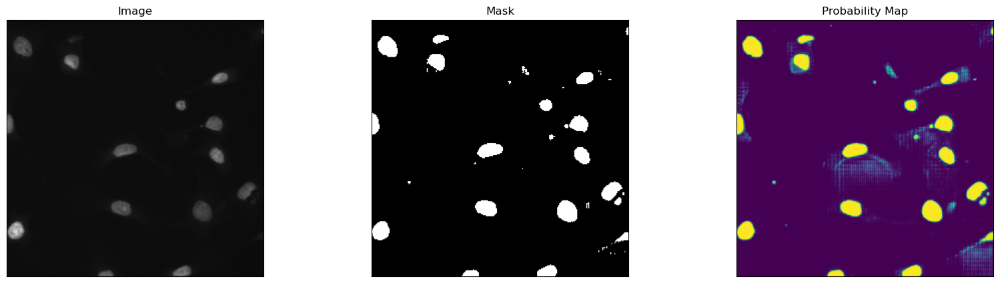

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=44: 0.1001


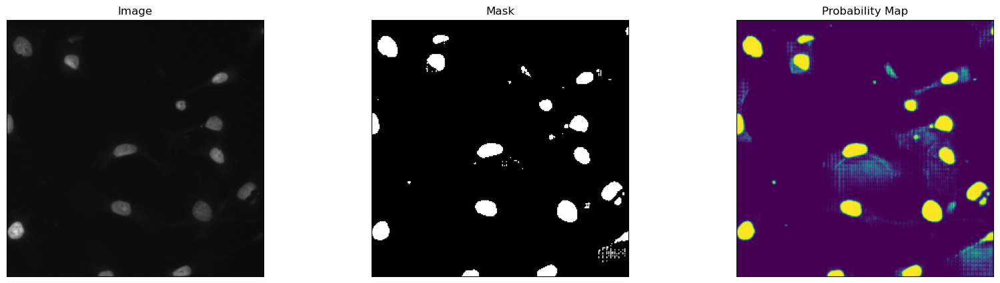

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=45: 0.1038


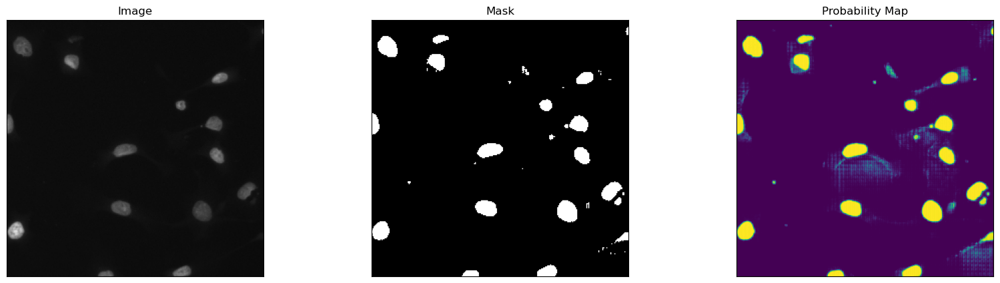

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=46: 0.1046


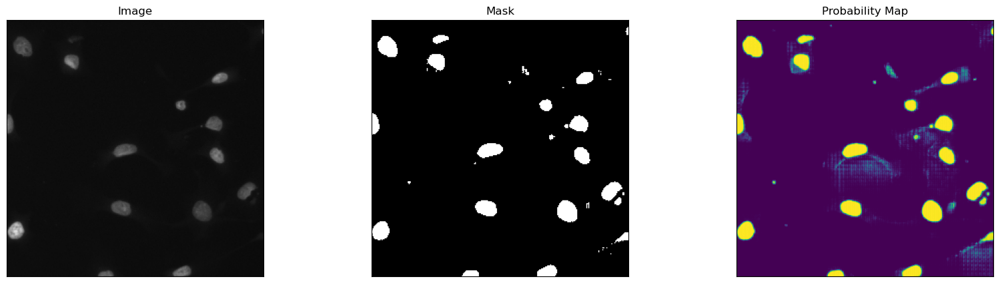

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=47: 0.1021


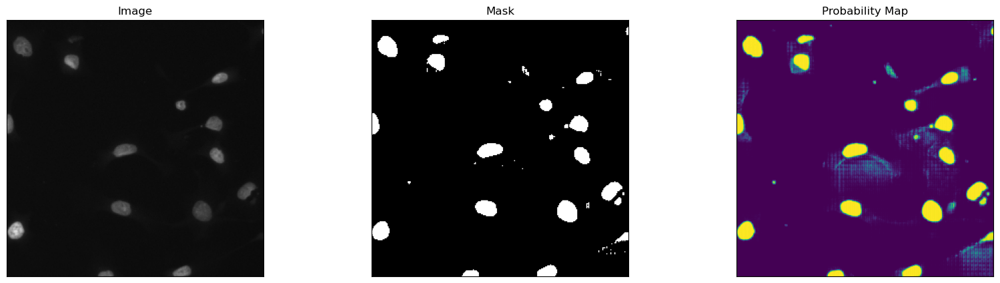

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=48: 0.1021


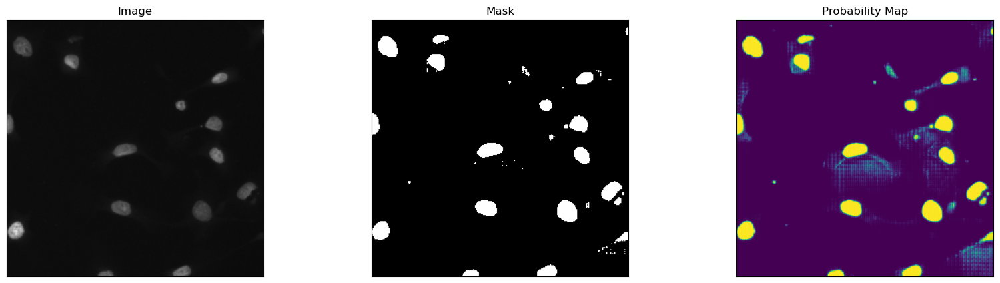

<class 'torch.Tensor'> torch.Size([1, 256, 256])
IoU between predicted and ground truth mask for Training Data=49: 0.0997


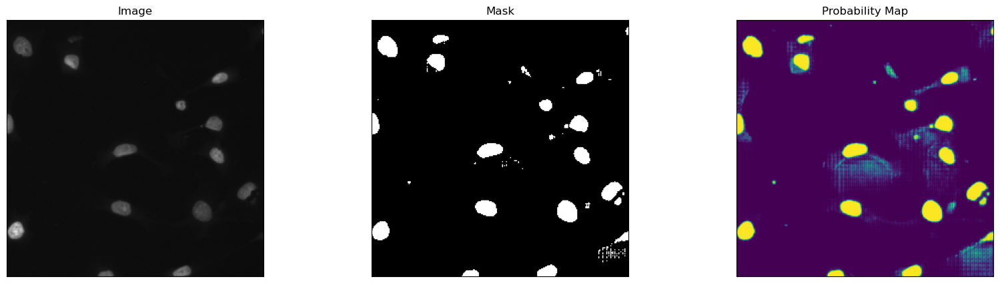

Average MAP (mean average precision) of 50 randomly chosen training images: 0.10223917126655578


In [25]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

# let's take a random training example
idx = random.randint(0, len(train_dataset_tmp)-1)
mean_iou_train = []
count = 50
transform_new = transforms.Compose([
            transforms.Resize((256, 256)),  # Resize to target size (256x256)
            transforms.ToTensor(),  # Convert to PyTorch tensor (optional, depending on your needs)
        ])
for i in range(count):
    # load image
    test_image = transform(Image.fromarray(np.array(train_dataset_tmp[idx]['image'].convert("RGB"))))

    # get box prompt based on ground truth segmentation map
    ground_truth_mask = np.array(train_dataset_tmp[idx]["mask"].convert("L"))
    prompt = get_bounding_boxes(ground_truth_mask)

    # prepare image + box prompt for the model
    inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")

    # Move the input tensor to the GPU if it's not already there
    inputs = {k: v.to(device) for k, v in inputs.items()}

    my_sam_model.eval()

    # forward pass
    with torch.no_grad():
        outputs = my_sam_model(**inputs, multimask_output=False)

    # apply sigmoid
    medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
    # convert soft mask to hard mask

    medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
    medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)
    
    # Calculate IoU using monai's compute_metric function
    val = outputs.pred_masks.squeeze(1).squeeze(0)[0].cpu()
    max_val = val.max().item() 
    min_val = val.min().item()
    predicted_mask = (val - min_val) / (max_val - min_val)
    print(type(predicted_mask), predicted_mask.shape)
    iou = calculate_iou(predicted_mask=predicted_mask, ground_truth_mask=transform_new(Image.fromarray(np.array(train_dataset_tmp[idx]['mask'].convert("L")))))
    # Print or use the IoU value
    print(f"IoU between predicted and ground truth mask for Training Data={i}: {iou:.4f}")
    mean_iou_train.append(iou)
    
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))

    # Plot the first image on the left
    axes[0].imshow(np.array(test_image), cmap='gray')  # Assuming the first image is grayscale
    axes[0].set_title("Image")

    # Plot the second image on the right
    axes[1].imshow(medsam_seg[0].reshape(256, 256), cmap='gray')  # Assuming the second image is grayscale
    axes[1].set_title("Mask")

    # Plot the second image on the right
    axes[2].imshow(medsam_seg_prob[0].reshape(256, 256))  # Assuming the second image is grayscale
    axes[2].set_title("Probability Map")

    # Hide axis ticks and labels
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    # Display the images side by side
    plt.show()
print(f"Average MAP (mean average precision) of {count} randomly chosen training images:", np.mean(mean_iou_train))

In [26]:
# Define the size of your array
array_size = 256

# Define the size of your grid
grid_size = 16

# Generate the grid points
x = np.linspace(0, array_size-1, grid_size)
y = np.linspace(0, array_size-1, grid_size)

# Generate a grid of coordinates
xv, yv = np.meshgrid(x, y)

# Convert the numpy arrays to lists
xv_list = xv.tolist()
yv_list = yv.tolist()

# Combine the x and y coordinates into a list of list of lists
input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]

#We need to reshape our nxn grid to the expected shape of the input_points tensor
# (batch_size, point_batch_size, num_points_per_image, 2),
# where the last dimension of 2 represents the x and y coordinates of each point.
#batch_size: The number of images you're processing at once.
#point_batch_size: The number of point sets you have for each image.
#num_points_per_image: The number of points in each set.
input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)

In [27]:
print(np.array(input_points).shape)

(1, 1, 256, 2)


IoU between predicted and ground truth mask for Validation Image=0: 0.0849


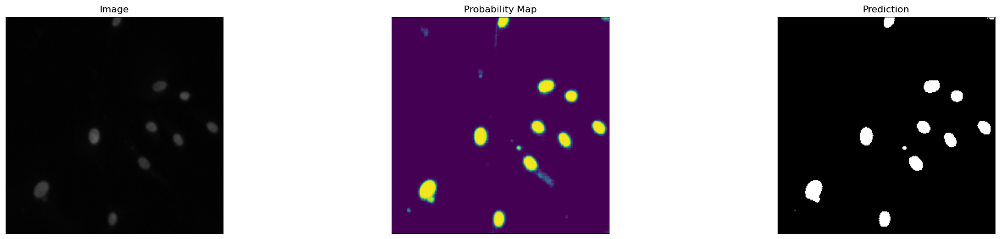

IoU between predicted and ground truth mask for Validation Image=1: 0.2925


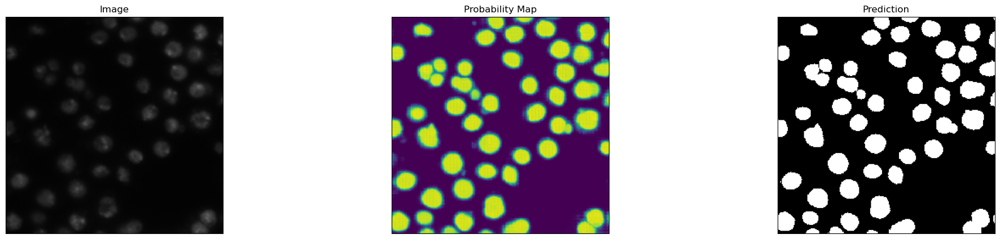

IoU between predicted and ground truth mask for Validation Image=2: 0.2136


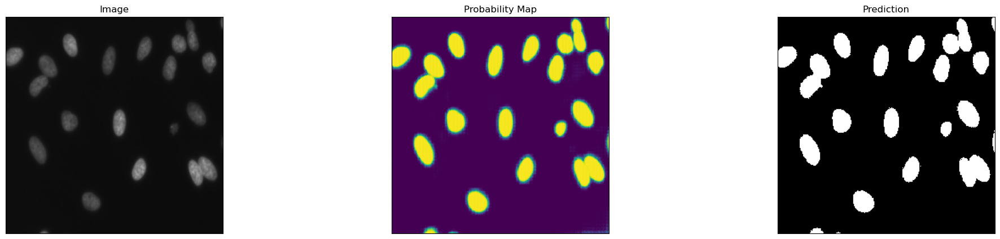

IoU between predicted and ground truth mask for Validation Image=3: 0.1079


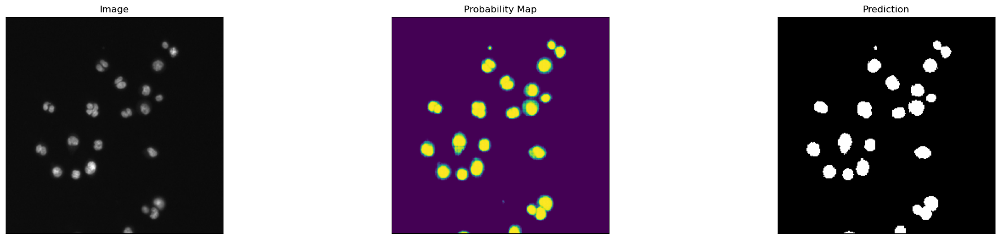

IoU between predicted and ground truth mask for Validation Image=4: 0.0988


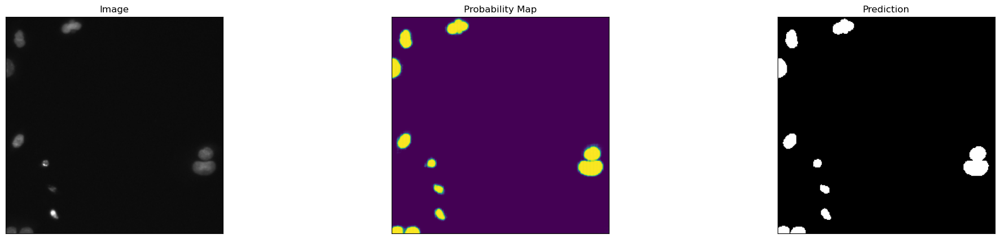

IoU between predicted and ground truth mask for Validation Image=5: 0.2973


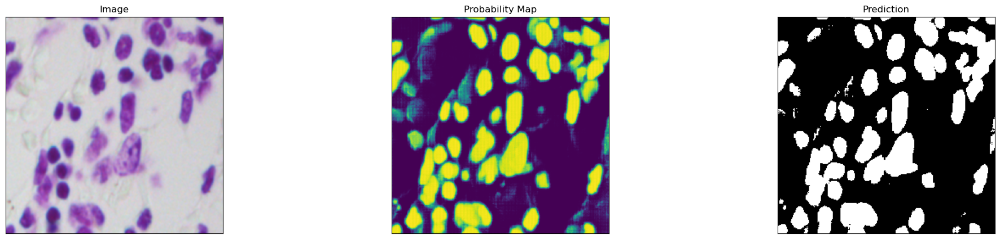

IoU between predicted and ground truth mask for Validation Image=6: 0.2087


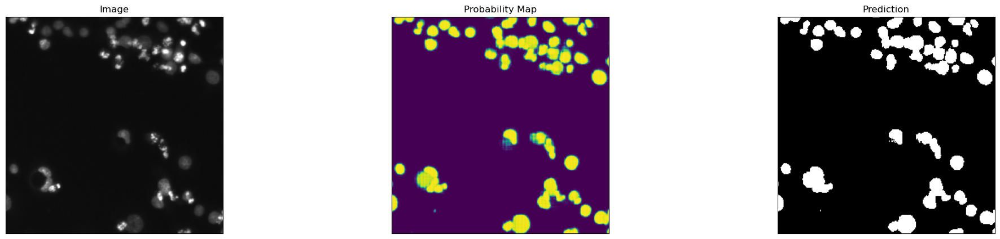

IoU between predicted and ground truth mask for Validation Image=7: 0.4552


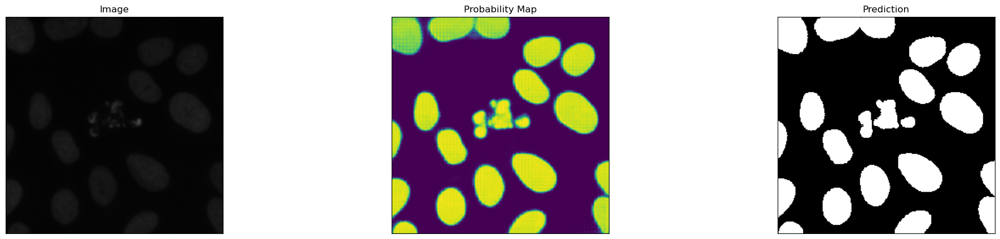

IoU between predicted and ground truth mask for Validation Image=8: 0.1601


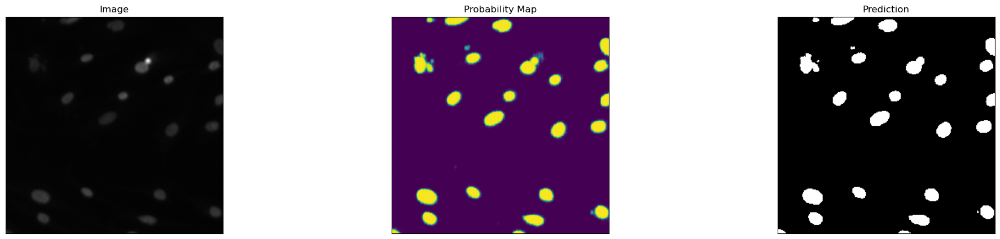

IoU between predicted and ground truth mask for Validation Image=9: 0.0836


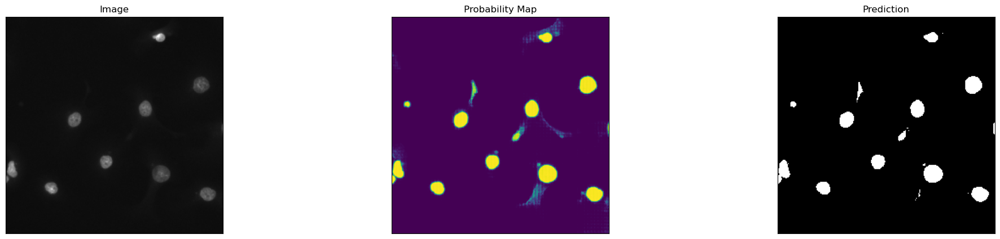

IoU between predicted and ground truth mask for Validation Image=10: 0.4755


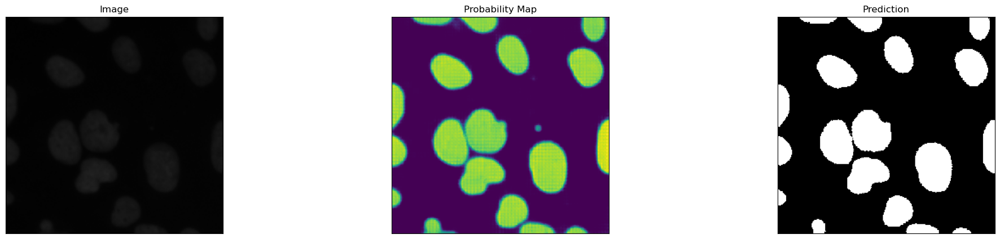

IoU between predicted and ground truth mask for Validation Image=11: 0.3986


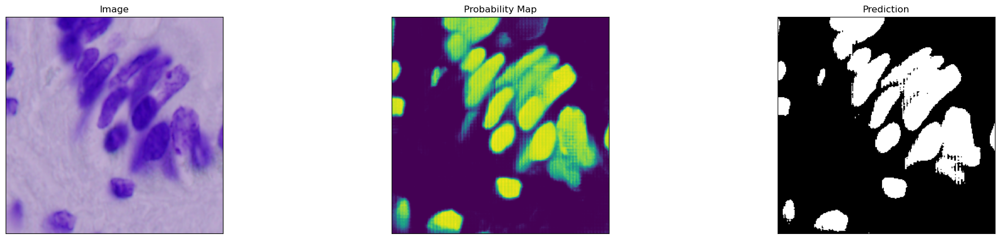

IoU between predicted and ground truth mask for Validation Image=12: 0.3294


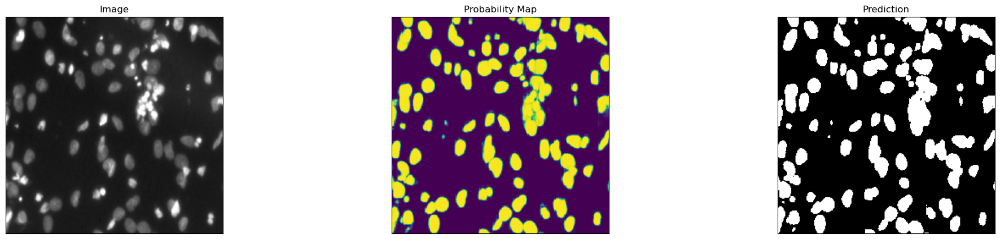

IoU between predicted and ground truth mask for Validation Image=13: 0.4828


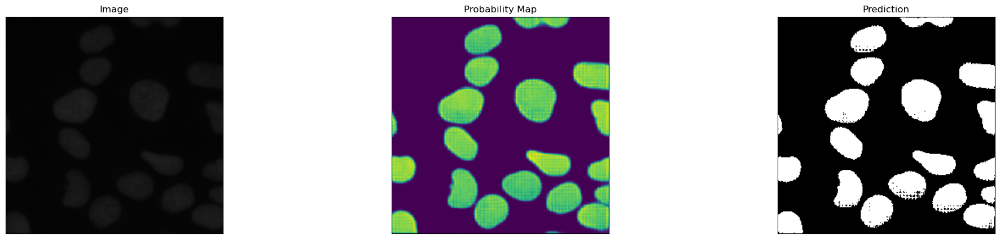

IoU between predicted and ground truth mask for Validation Image=14: 0.5174


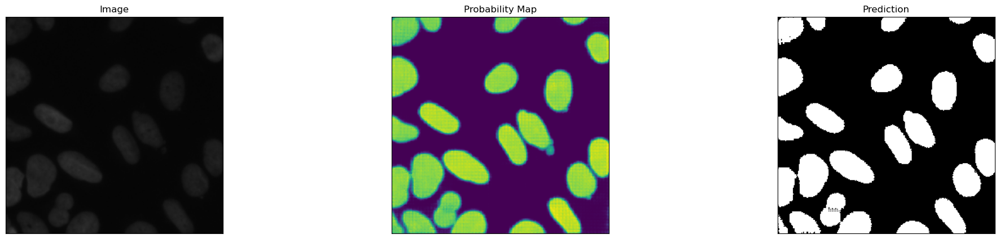

IoU between predicted and ground truth mask for Validation Image=15: 0.1375


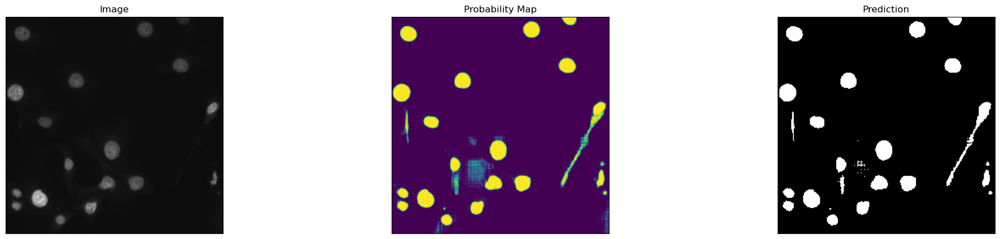

IoU between predicted and ground truth mask for Validation Image=16: 0.3908


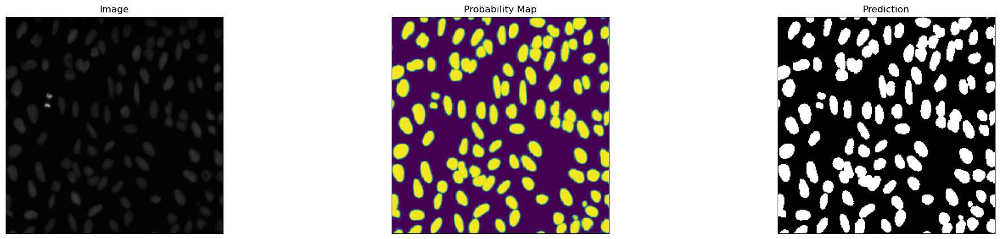

IoU between predicted and ground truth mask for Validation Image=17: 0.1513


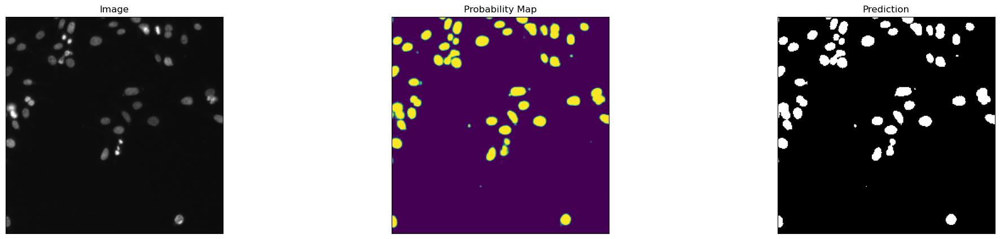

IoU between predicted and ground truth mask for Validation Image=18: 0.1560


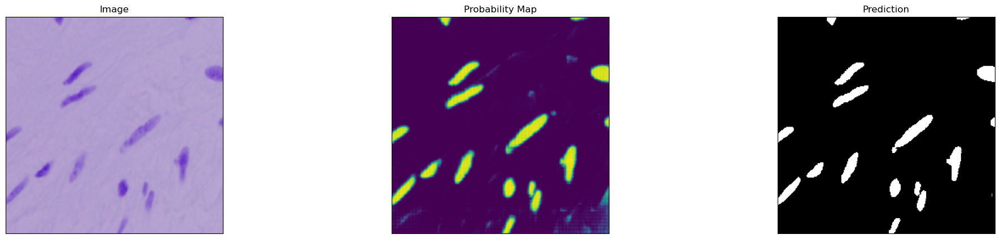

IoU between predicted and ground truth mask for Validation Image=19: 0.5244


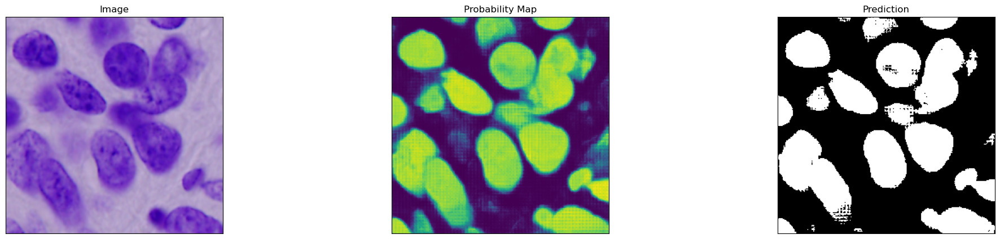

IoU between predicted and ground truth mask for Validation Image=20: 0.0680


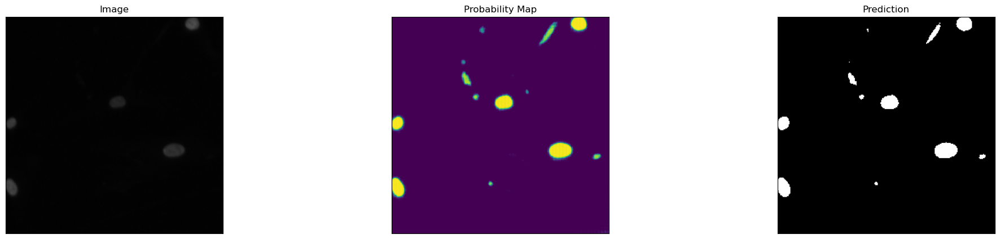

IoU between predicted and ground truth mask for Validation Image=21: 0.2828


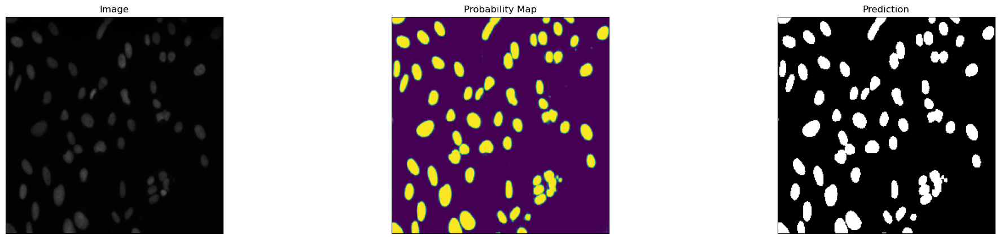

IoU between predicted and ground truth mask for Validation Image=22: 0.5256


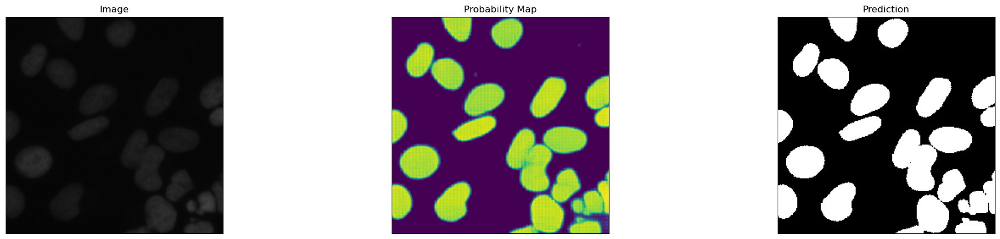

IoU between predicted and ground truth mask for Validation Image=23: 0.3694


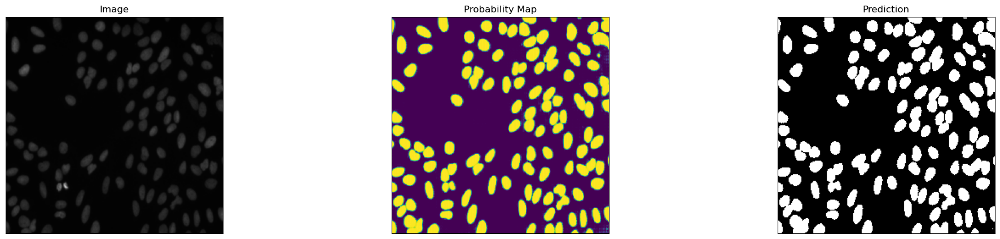

IoU between predicted and ground truth mask for Validation Image=24: 0.0643


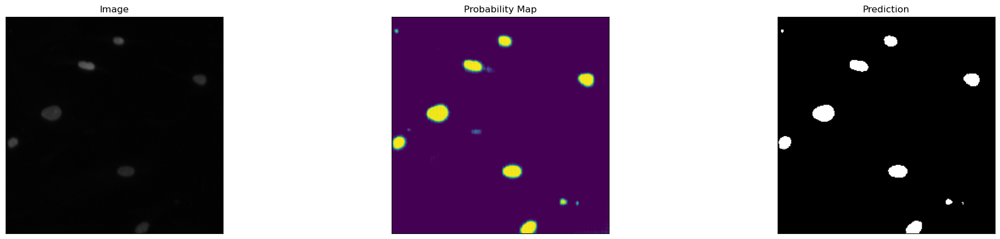

IoU between predicted and ground truth mask for Validation Image=25: 0.4647


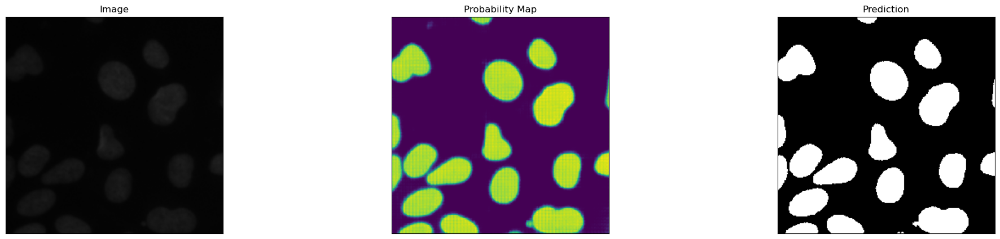

IoU between predicted and ground truth mask for Validation Image=26: 0.3986


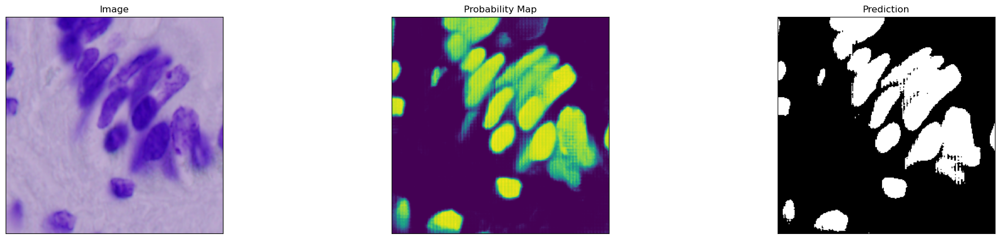

IoU between predicted and ground truth mask for Validation Image=27: 0.3674


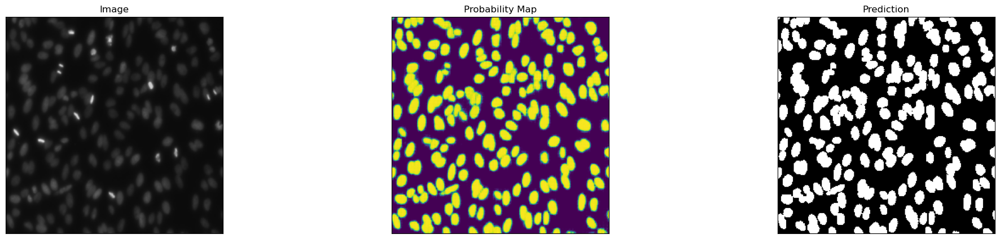

IoU between predicted and ground truth mask for Validation Image=28: 0.3548


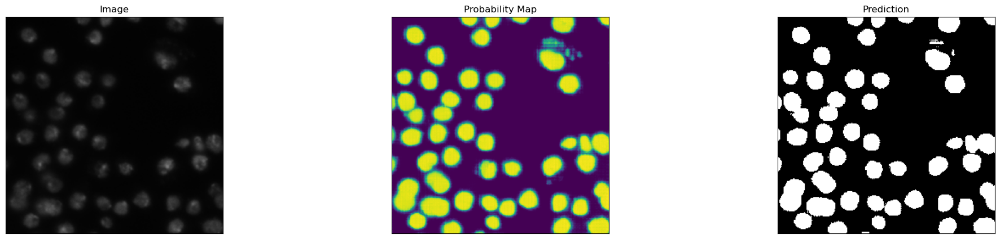

IoU between predicted and ground truth mask for Validation Image=29: 0.1079


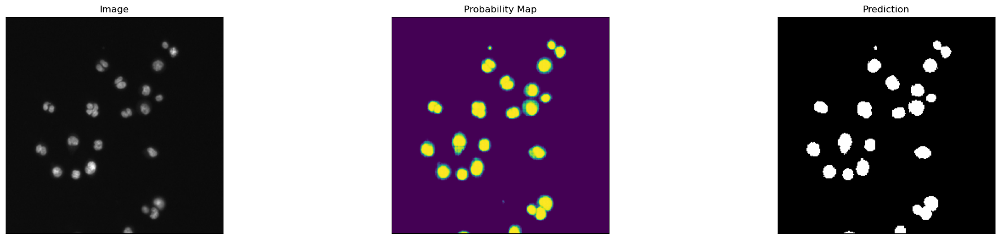

IoU between predicted and ground truth mask for Validation Image=30: 0.2255


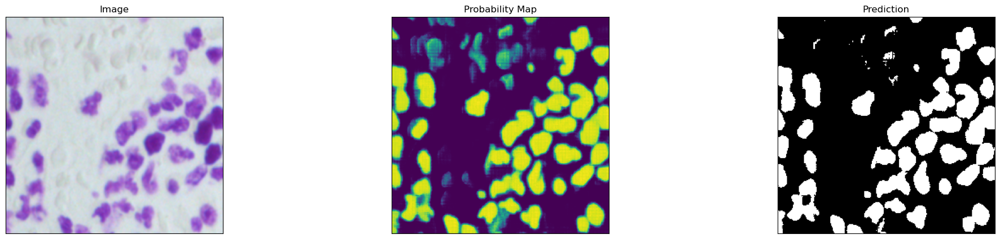

IoU between predicted and ground truth mask for Validation Image=31: 0.4654


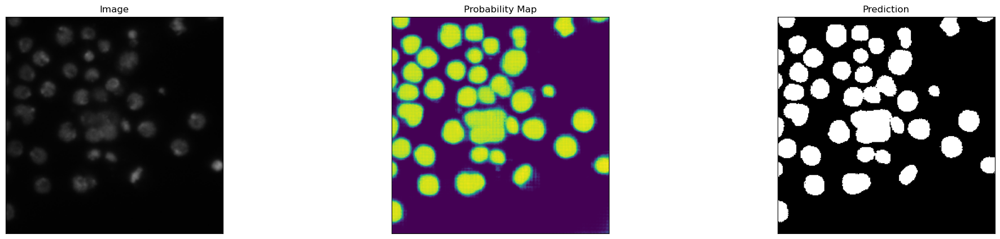

IoU between predicted and ground truth mask for Validation Image=32: 0.1037


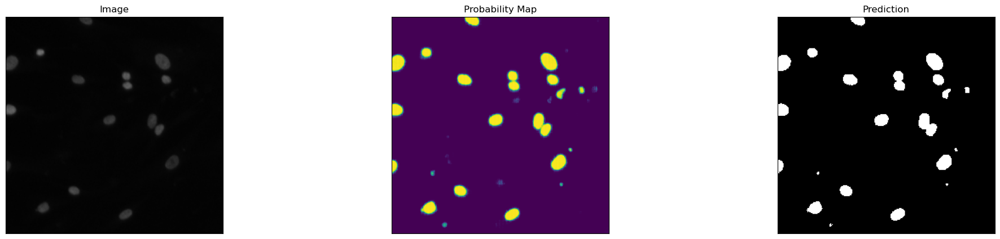

IoU between predicted and ground truth mask for Validation Image=33: 0.5501


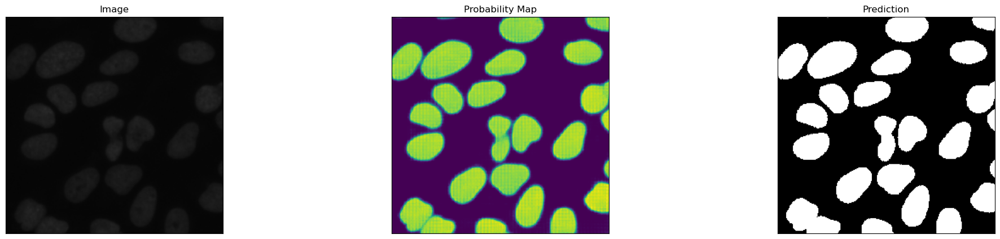

IoU between predicted and ground truth mask for Validation Image=34: 0.1601


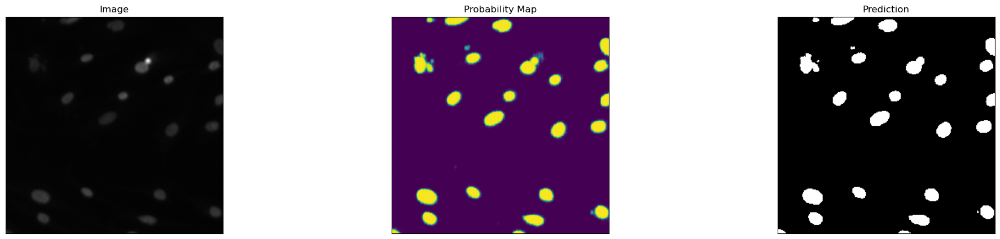

IoU between predicted and ground truth mask for Validation Image=35: 0.3188


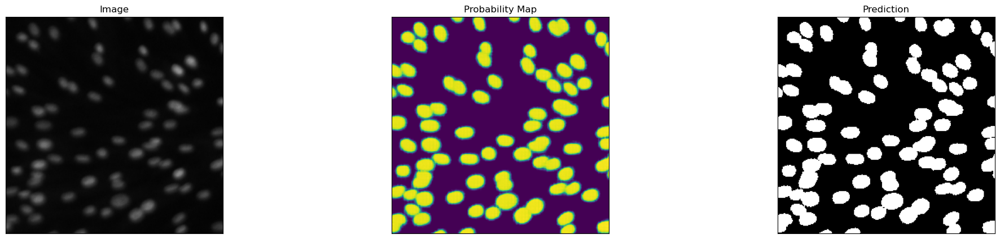

IoU between predicted and ground truth mask for Validation Image=36: 0.4828


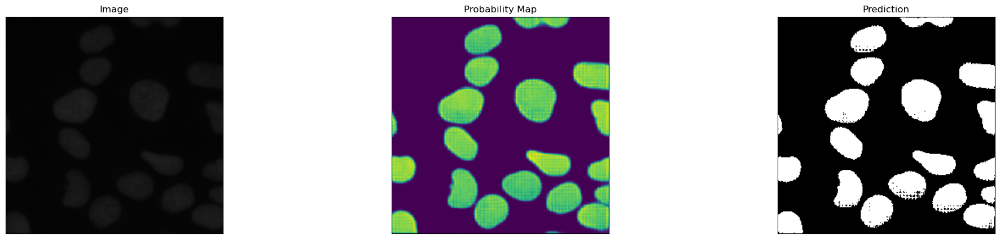

IoU between predicted and ground truth mask for Validation Image=37: 0.2318


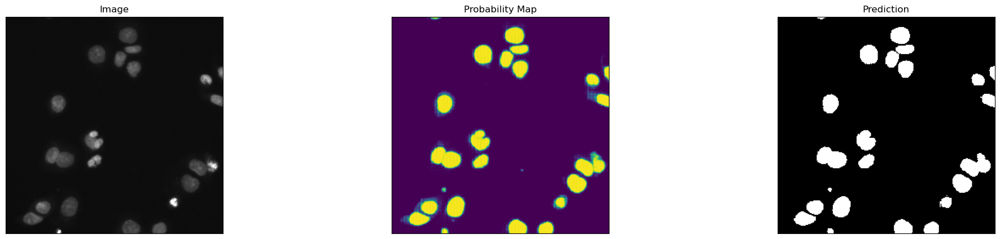

IoU between predicted and ground truth mask for Validation Image=38: 0.0643


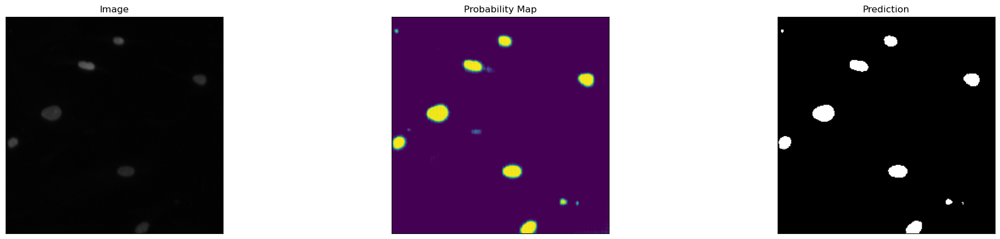

IoU between predicted and ground truth mask for Validation Image=39: 0.0794


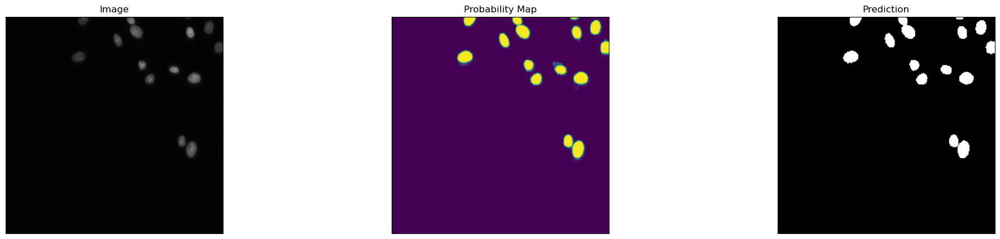

IoU between predicted and ground truth mask for Validation Image=40: 0.0805


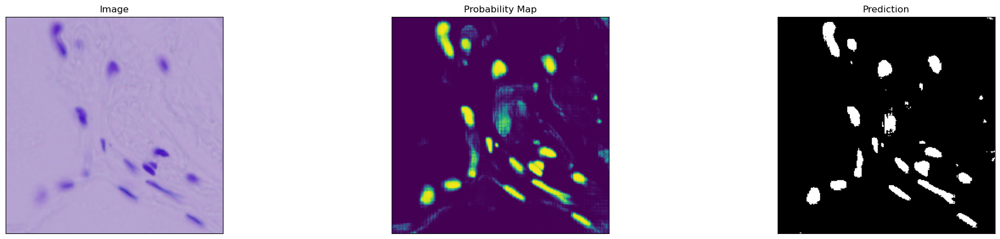

IoU between predicted and ground truth mask for Validation Image=41: 0.2136


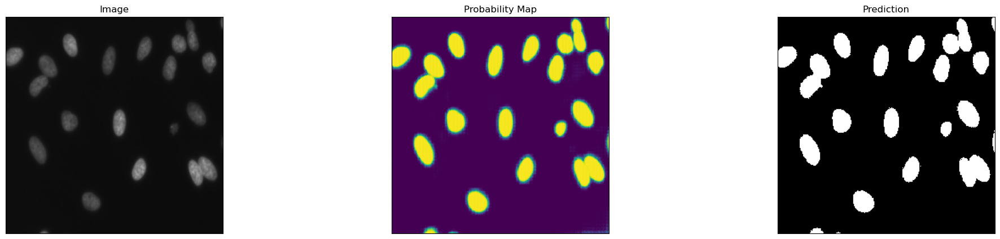

IoU between predicted and ground truth mask for Validation Image=42: 0.0741


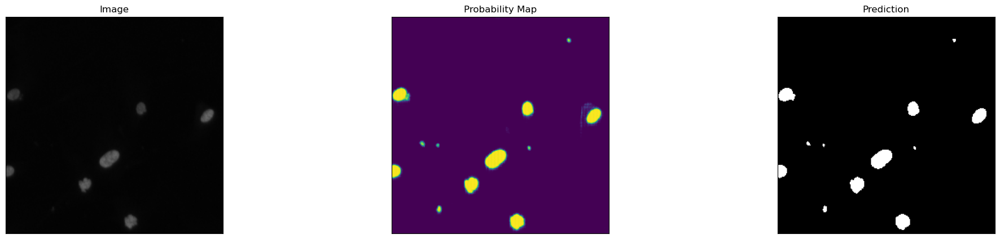

IoU between predicted and ground truth mask for Validation Image=43: 0.0849


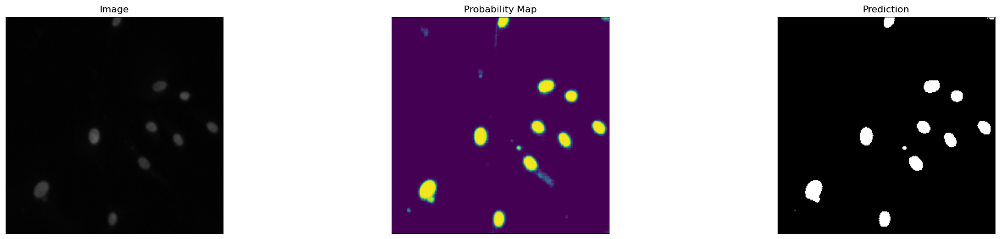

IoU between predicted and ground truth mask for Validation Image=44: 0.0849


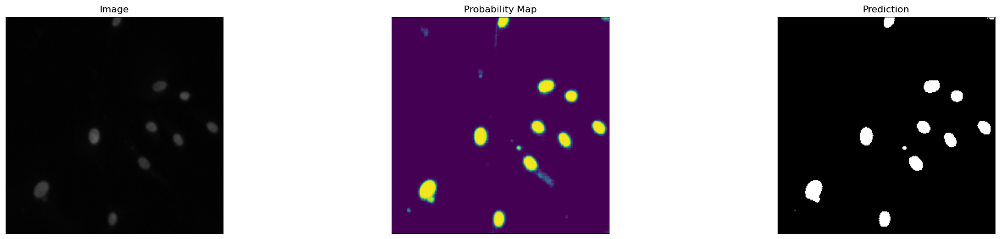

IoU between predicted and ground truth mask for Validation Image=45: 0.0394


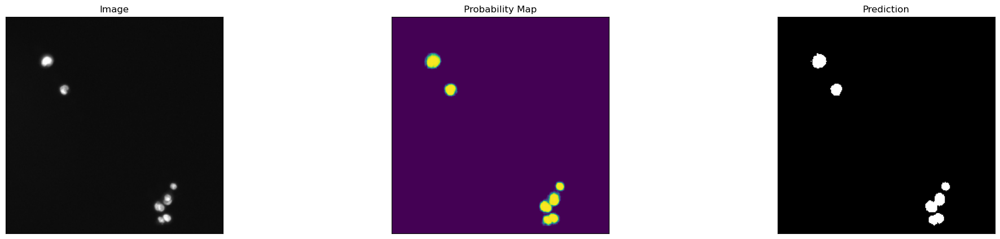

IoU between predicted and ground truth mask for Validation Image=46: 0.3977


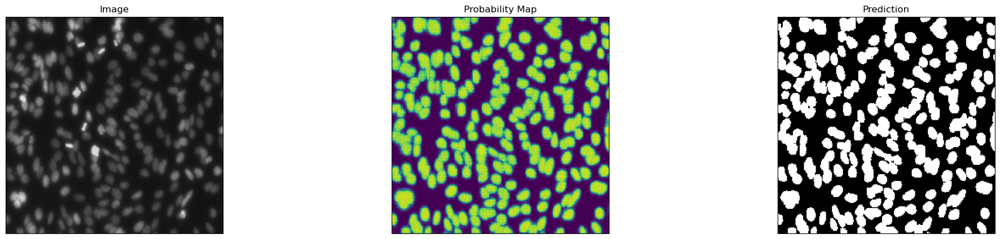

IoU between predicted and ground truth mask for Validation Image=47: 0.2471


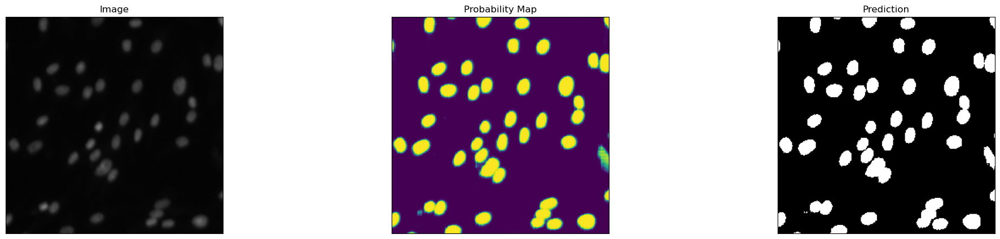

IoU between predicted and ground truth mask for Validation Image=48: 0.0635


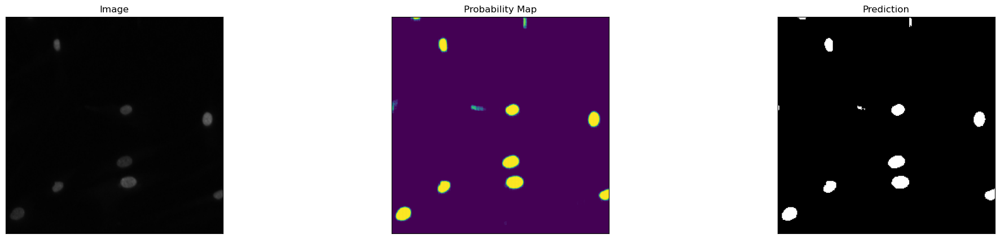

IoU between predicted and ground truth mask for Validation Image=49: 0.3694


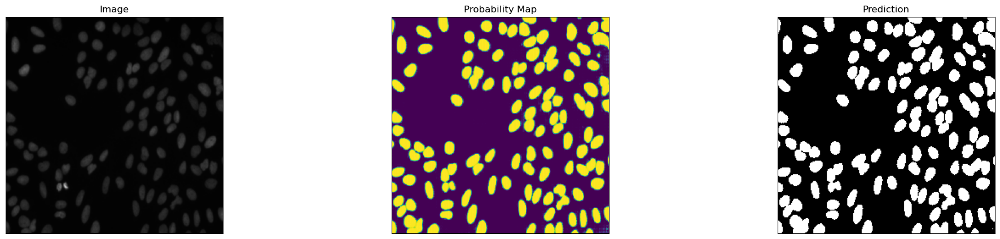

Average MAP (mean average precision) of 50 randomly chosen validation image: 0.25813681848347186


In [28]:
import numpy as np
import random
import torch
import matplotlib.pyplot as plt

mean_iou = []
count = 50
for i in range(count):
    idx = random.randint(0, len(validation_dataset_tmp)-1)
    transform_new = transforms.Compose([
        transforms.Resize((256, 256)),  # Resize to target size (256x256)
        transforms.ToTensor(),  # Convert to PyTorch tensor (optional, depending on your needs)
    ])
    single_patch = transform(Image.fromarray(np.array(validation_dataset_tmp[idx]['image'].convert("RGB"))))
    # prepare image for the model

    #First try without providing any prompt (no bounding box or input_points)
    #inputs = processor(single_patch, return_tensors="pt")
    #Now try with bounding boxes. Remember to uncomment.
    inputs = processor(single_patch, input_points=input_points, return_tensors="pt")

    # Move the input tensor to the GPU if it's not already there
    inputs = {k: v.to(device) for k, v in inputs.items()}
    my_sam_model.eval()


    # forward pass
    with torch.no_grad():
      outputs = my_sam_model(**inputs, multimask_output=False)

    # apply sigmoid
    single_patch_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
    # convert soft mask to hard mask
    single_patch_prob = single_patch_prob.cpu().numpy().squeeze()
    single_patch_prediction = (single_patch_prob > 0.5).astype(np.uint8)


# Calculate IoU using monai's compute_metric function
    val = outputs.pred_masks.squeeze(1).cpu()
    max_val = val.max().item() 
    min_val = val.min().item()
    predicted_mask = (val - min_val) / (max_val - min_val)
    iou = calculate_iou(predicted_mask=predicted_mask, ground_truth_mask=transform_new(Image.fromarray(np.array(validation_dataset_tmp[idx]['mask'].convert("L")))))
    mean_iou.append(iou)

    # Print or use the IoU value
    print(f"IoU between predicted and ground truth mask for Validation Image={i}: {iou:.4f}")

    fig, axes = plt.subplots(1, 3, figsize=(25, 5))

    # Plot the first image on the left
    axes[0].imshow(np.array(single_patch), cmap='gray')  # Assuming the first image is grayscale
    axes[0].set_title("Image")

    # Plot the second image on the right
    axes[1].imshow(single_patch_prob)  # Assuming the second image is grayscale
    axes[1].set_title("Probability Map")

    # Plot the second image on the right
    axes[2].imshow(single_patch_prediction, cmap='gray')  # Assuming the second image is grayscale
    axes[2].set_title("Prediction")

    # Hide axis ticks and labels
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    # Display the images side by side
    plt.show()
print(f"Average MAP (mean average precision) of {count} randomly chosen validation image:", np.mean(mean_iou))